In [2]:
# <b><u> Project Title : Predicting the news popularity in multiple social media platforms. </u></b>

## <b> Problem Description </b>

### This is a large data set of news items and their respective social feedback on multiple platforms: Facebook, Google+ and LinkedIn.The collected data relates to a period of 8 months, between November 2015 and July 2016, accounting for about 100,000 news items on four different topics: Economy, Microsoft, Obama and Palestine.


## <b> Data Description </b>

### <b>Attribute Information: </b>

* ### IDLink (numeric): Unique identifier of news items
* ### Title (string): Title of the news item according to the official media sources
* ### Headline (string): Headline of the news item according to the official media sources
* ### Source (string): Original news outlet that published the news item
* ### Topic (string): Query topic used to obtain the items in the official media sources
* ### PublishDate (timestamp): Date and time of the news items' publication
* ### SentimentTitle (numeric): Sentiment score of the text in the news items' title
* ### SentimentHeadline (numeric): Sentiment score of the text in the news items' headline
* ### Facebook (numeric): Final value of the news items' popularity according to the social media source Facebook
* ### GooglePlus (numeric): Final value of the news items' popularity according to the social media source Google+
* ### LinkedIn (numeric): Final value of the news items' popularity according to the social media source LinkedIn


### VARIABLES OF SOCIAL FEEDBACK DATA

* ### IDLink (numeric): Unique identifier of news items
* ### TS1 (numeric): Level of popularity in time slice 1 (0-20 minutes upon publication)
* ### TS2 (numeric): Level of popularity in time slice 2 (20-40 minutes upon publication)
* ### TS... (numeric): Level of popularity in time slice ...
* ### TS144 (numeric): Final level of popularity after 2 days upon publication

In [1]:
# load the libraries
import os
import sys
import string
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling as pp
import seaborn as sns
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import SGDRegressor
from sklearn.tree import DecisionTreeRegressor, export_graphviz
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_squared_log_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor, AdaBoostRegressor 
from sklearn.neighbors import KNeighborsRegressor
from catboost import CatBoostRegressor
from xgboost.sklearn import XGBRegressor
from sklearn.svm import SVR
import sklearn.feature_selection as fs 
import statsmodels.api as sm
import scipy.stats as stats
from statsmodels.formula.api import ols
from patsy import dmatrices
from statsmodels.stats.outliers_influence import variance_inflation_factor
%matplotlib inline
import pydotplus
from IPython.display import Image

In [2]:
!pip install wordcloud

In [2]:
from icecream import ic
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer
import category_encoders as ce
from sklearn.model_selection import GridSearchCV
from IPython.display import Image
from wordcloud import WordCloud
from sklearn.preprocessing import MinMaxScaler

import warnings
warnings.filterwarnings('ignore')
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, KFold

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\peddi\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
os.chdir(r'D:\Data science\Alma better\News popularity prediction')

#### Viewing the raw dataset 

In [4]:
df=pd.read_csv('News_Final.csv')
df.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,obama,2002-04-02 00:00:00,0.000000,-0.053300,-1,-1,-1
1,10423.0,A Look at the Health of the Chinese Economy,"Tim Haywood, investment director business-unit...",Bloomberg,economy,2008-09-20 00:00:00,0.208333,-0.156386,-1,-1,-1
2,18828.0,Nouriel Roubini: Global Economy Not Back to 2008,"Nouriel Roubini, NYU professor and chairman at...",Bloomberg,economy,2012-01-28 00:00:00,-0.425210,0.139754,-1,-1,-1
3,27788.0,Finland GDP Expands In Q4,Finland's economy expanded marginally in the t...,RTT News,economy,2015-03-01 00:06:00,0.000000,0.026064,-1,-1,-1
4,27789.0,"Tourism, govt spending buoys Thai economy in J...",Tourism and public spending continued to boost...,The Nation - Thailand&#39;s English news,economy,2015-03-01 00:11:00,0.000000,0.141084,-1,-1,-1


In [5]:
df.shape

(93239, 11)

###  Missing value analysis
- There are two ways of dealing with missing values that is either to remove/drop them or impute them using different statistical techniques like mean,median,mode or using domain knowledge and fill them or using some other techniques like using decision tree, KNN imputer for filling them.
- I have just dropped them as there are only few missing values which would be <0.01%(~0.003%) of total data.

In [6]:
social_df=df.copy()

In [7]:
social_df.isnull().sum()

IDLink                 0
Title                  0
Headline              15
Source               279
Topic                  0
PublishDate            0
SentimentTitle         0
SentimentHeadline      0
Facebook               0
GooglePlus             0
LinkedIn               0
dtype: int64

In [8]:
social_df['Topic'].value_counts()

economy      33928
obama        28610
microsoft    21858
palestine     8843
Name: Topic, dtype: int64

In [9]:
social_df.dropna(axis=0,inplace=True,how='any')

In [10]:
social_df.isnull().sum()

IDLink               0
Title                0
Headline             0
Source               0
Topic                0
PublishDate          0
SentimentTitle       0
SentimentHeadline    0
Facebook             0
GooglePlus           0
LinkedIn             0
dtype: int64

In [11]:
social_df.reset_index(drop=True,inplace=True,)

### Data cleaning and Data Analysis 
- In this section of data cleaning after missing value analysis, I have changed the data types and introduced new features for better analysis and predictions.
- I have cleaned the text by removing punctuations, stop words, lemmatization and extracting new features from text columns (News Title,Headlines)by using Tfidf vectorizer and remving unnecssary columns out of created columnns.
- Finally combining all the new dataframes created in the process of data cleaning and making new processsed data out of existing columns or data for news popularity prediction.

In [12]:
social_df.shape

(92945, 11)

In [13]:
social_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   IDLink             92945 non-null  float64
 1   Title              92945 non-null  object 
 2   Headline           92945 non-null  object 
 3   Source             92945 non-null  object 
 4   Topic              92945 non-null  object 
 5   PublishDate        92945 non-null  object 
 6   SentimentTitle     92945 non-null  float64
 7   SentimentHeadline  92945 non-null  float64
 8   Facebook           92945 non-null  int64  
 9   GooglePlus         92945 non-null  int64  
 10  LinkedIn           92945 non-null  int64  
dtypes: float64(3), int64(3), object(5)
memory usage: 7.8+ MB


In [14]:
social_df.dtypes

IDLink               float64
Title                 object
Headline              object
Source                object
Topic                 object
PublishDate           object
SentimentTitle       float64
SentimentHeadline    float64
Facebook               int64
GooglePlus             int64
LinkedIn               int64
dtype: object

In [15]:
#converting datetime variable to correct data type (datetime) instead of it in object type
social_df['PublishDate']=pd.to_datetime(social_df['PublishDate'])

In [16]:
social_df.head(3)

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,obama,2002-04-02,0.000000,-0.053300,-1,-1,-1
1,10423.0,A Look at the Health of the Chinese Economy,"Tim Haywood, investment director business-unit...",Bloomberg,economy,2008-09-20,0.208333,-0.156386,-1,-1,-1
2,18828.0,Nouriel Roubini: Global Economy Not Back to 2008,"Nouriel Roubini, NYU professor and chairman at...",Bloomberg,economy,2012-01-28,-0.425210,0.139754,-1,-1,-1


In [17]:
social_df.tail(4)

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn
92941,61865.0,Russian PM proposes to use conservative and to...,"In addition, establish stimulating economic po...",TASS,economy,2016-07-07 15:31:10,0.072194,0.000000,-1,0,1
92942,104793.0,Palestinian Government Uses Foreign Aid To Pay...,The Palestinian government spends nearly $140 ...,Daily Caller,palestine,2016-07-07 15:38:26,0.291667,-0.139754,5,1,0
92943,104794.0,Palestine Youth Orchestra prepares for first U...,Palestine Youth Orchestra prepares for first U...,Ahram Online,palestine,2016-07-07 15:59:22,0.121534,0.092313,0,0,0
92944,61870.0,Sausalito businesswoman wins $10000 in Microso...,"Goldstein, the proprietor of the TG Travel Gro...",East Bay Times,microsoft,2016-07-07 16:16:11,0.000000,0.054554,-1,1,0


In [18]:
# creating new columns day,month,year and dropping publishdate columns
social_df['Published_year']=social_df['PublishDate'].dt.year
social_df['Published_month']=social_df['PublishDate'].dt.month
social_df['Published_date']=social_df['PublishDate'].dt.day

In [19]:
social_df.head(3)

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,obama,2002-04-02,0.000000,-0.053300,-1,-1,-1,2002,4,2
1,10423.0,A Look at the Health of the Chinese Economy,"Tim Haywood, investment director business-unit...",Bloomberg,economy,2008-09-20,0.208333,-0.156386,-1,-1,-1,2008,9,20
2,18828.0,Nouriel Roubini: Global Economy Not Back to 2008,"Nouriel Roubini, NYU professor and chairman at...",Bloomberg,economy,2012-01-28,-0.425210,0.139754,-1,-1,-1,2012,1,28


In [20]:
social_df.drop(axis=1,columns=['PublishDate'],inplace=True)

In [21]:
social_df.head(1)

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,obama,0.0,-0.0533,-1,-1,-1,2002,4,2


In [22]:
# stats on variables present in the dataset
social_df.describe()

,IDLink,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date
count,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000
mean,51488.725537,-0.005326,-0.027490,113.497897,3.901124,16.600882,2015.778826,5.294637,15.595998
std,30391.373770,0.136501,0.142063,621.120839,18.520443,154.700274,0.418267,3.694734,8.828945
min,1.000000,-0.950694,-0.755433,-1.000000,-1.000000,-1.000000,2002.000000,1.000000,1.000000
25%,24240.000000,-0.079057,-0.114598,0.000000,0.000000,0.000000,2016.000000,2.000000,8.000000
50%,52159.000000,0.000000,-0.026064,5.000000,0.000000,0.000000,2016.000000,4.000000,16.000000
75%,76489.000000,0.064892,0.059868,33.000000,2.000000,4.000000,2016.000000,6.000000,23.000000
max,104802.000000,0.962354,0.964646,49211.000000,1267.000000,20341.000000,2016.000000,12.000000,31.000000


In [23]:
# Converting all the upper case or lower case to Capitalized letter in topic columns
social_df['Topic']=social_df['Topic'].str.capitalize()

In [24]:
social_df.head(1)

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,Obama,0.0,-0.0533,-1,-1,-1,2002,4,2


In [25]:
social_df['Source'].value_counts()

Bloomberg               1732
Reuters                 1321
ABC News                1098
New York Times           992
The Guardian             933
                        ... 
Progress.org (blog)        1
Southeast Asia GLOBE       1
The Actuary                1
Space.com                  1
Freedom Newspaper          1
Name: Source, Length: 5755, dtype: int64

In [26]:
social_df['Topic'].value_counts()

Economy      33889
Obama        28598
Microsoft    21851
Palestine     8607
Name: Topic, dtype: int64

In [27]:
social_df['Length_of_title']=social_df['Title'].apply(len)
social_df['Length_of_Headline']=social_df['Headline'].apply(len)

In [28]:
social_df.head(3)

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline
0,99248.0,Obama Lays Wreath at Arlington National Cemetery,Obama Lays Wreath at Arlington National Cemete...,USA TODAY,Obama,0.000000,-0.053300,-1,-1,-1,2002,4,2,48,127
1,10423.0,A Look at the Health of the Chinese Economy,"Tim Haywood, investment director business-unit...",Bloomberg,Economy,0.208333,-0.156386,-1,-1,-1,2008,9,20,43,137
2,18828.0,Nouriel Roubini: Global Economy Not Back to 2008,"Nouriel Roubini, NYU professor and chairman at...",Bloomberg,Economy,-0.425210,0.139754,-1,-1,-1,2012,1,28,48,137


In [29]:
# preprocessing for working on text data
def text_process(msg):
    nopunc =[char for char in msg if char not in string.punctuation]
    nopunc=''.join(nopunc)
    return ' '.join([word for word in nopunc.split() if word.lower() not in stopwords.words('english')])

In [30]:
n=[i for i in social_df['Title'][2] if i not in string.punctuation]
n=''.join(n)
n

'Nouriel Roubini Global Economy Not Back to 2008'

In [31]:
([c for c in n.split()]) #if c.lower() not in stopwords.words('english')])

['Nouriel', 'Roubini', 'Global', 'Economy', 'Not', 'Back', 'to', '2008']

In [32]:
social_df['Title'][67]

'Recovery is leaving too many behind: NUL president'

#### Using str.cat method:
- The str.cat() function is used to concatenate strings in the Series/Index with given separator.
- It is used for combining different text into one text.

In [33]:
# One of the useful method for combining title and headline text for further processing
social_df['Cleaned_Title_and_Headline']=social_df['Title'].str.cat(social_df['Headline'],sep=' ',)

In [34]:
# Cleaning text for title and headlines column
social_df['Cleaned_Title_and_Headline']=social_df['Cleaned_Title_and_Headline'].apply(text_process)

In [35]:
social_df.tail(3)

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Cleaned_Title_and_Headline
92942,104793.0,Palestinian Government Uses Foreign Aid To Pay...,The Palestinian government spends nearly $140 ...,Daily Caller,Palestine,0.291667,-0.139754,5,1,0,2016,7,7,67,142,Palestinian Government Uses Foreign Aid Pay Te...
92943,104794.0,Palestine Youth Orchestra prepares for first U...,Palestine Youth Orchestra prepares for first U...,Ahram Online,Palestine,0.121534,0.092313,0,0,0,2016,7,7,52,141,Palestine Youth Orchestra prepares first UK to...
92944,61870.0,Sausalito businesswoman wins $10000 in Microso...,"Goldstein, the proprietor of the TG Travel Gro...",East Bay Times,Microsoft,0.000000,0.054554,-1,1,0,2016,7,7,63,135,Sausalito businesswoman wins 10000 Microsoft W...


In [36]:
social_df['Cleaned_Title_and_Headline'][67]

'Recovery leaving many behind NUL president economy may recovering president National Urban League says leaving many neighborhoods behind'

In [37]:
social_df.reset_index(drop=True,inplace=True)

In [38]:
social_df.shape

(92945, 16)

In [39]:
ic(social_df['Title'][67402])
ic(social_df['Headline'][67402])
ic(social_df['Cleaned_Title_and_Headline'][67402]);

ic| social_df['Title'][67402]: 'Lloyds posts profit in line with hopes amid slowdown in UK economy'
ic| social_df['Headline'][67402]: ('LONDON, April 28 (Reuters) - Lloyds Banking Group reported underlying '
                                   'profits in line with expectations on Thursday, keeping first quarter')
ic| social_df['Cleaned_Title_and_Headline'][67402]: ('Lloyds posts profit line hopes amid slowdown UK economy LONDON April 28 '
                                                     'Reuters Lloyds Banking Group reported underlying profits line expectations '
                                                     'Thursday keeping first quarter')


In [40]:
vectorizer1=TfidfVectorizer(max_df=0.80,min_df=0.003,strip_accents='ascii')
tnh_vector=vectorizer1.fit_transform(social_df['Cleaned_Title_and_Headline'])

In [41]:
tnh_vector

<92945x1242 sparse matrix of type '<class 'numpy.float64'>'
	with 1099327 stored elements in Compressed Sparse Row format>

In [42]:
# features from title column
vectorizer1.get_feature_names()

['10',
 '100',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '20',
 '2008',
 '2009',
 '2014',
 '2015',
 '2016',
 '2017',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '29',
 '30',
 '365',
 '50',
 '950',
 'abbas',
 'able',
 'access',
 'according',
 'across',
 'act',
 'action',
 'actions',
 'activity',
 'actually',
 'add',
 'added',
 'adding',
 'address',
 'adds',
 'administration',
 'administrations',
 'affairs',
 'africa',
 'africas',
 'agency',
 'agenda',
 'ago',
 'agreement',
 'ahead',
 'aid',
 'aimed',
 'aims',
 'air',
 'allies',
 'allow',
 'almost',
 'along',
 'already',
 'also',
 'although',
 'amazon',
 'america',
 'american',
 'americans',
 'americas',
 'amid',
 'among',
 'amp',
 'analysis',
 'analyst',
 'analysts',
 'android',
 'anniversary',
 'announce',
 'announced',
 'announcement',
 'announces',
 'annual',
 'another',
 'antonin',
 'ap',
 'app',
 'appears',
 'apple',
 'approach',
 'apps',
 'april',
 'arab',
 'arabia',
 'area',
 'areas',
 'around',
 'asia',
 'as

In [43]:
tnh_vector.toarray()

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.24085083, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [44]:
ic(vectorizer1.inverse_transform(tnh_vector[78877]));

ic| vectorizer1.inverse_transform(tnh_vector[78877]): [array(['agency', 'germany', 'like', 'show', 'european', 'government',
                                                             'countrys', 'new', '2016', 'figures', 'economy'], dtype='<U15')]


In [45]:
ic(social_df['Source'][78877]);

ic| social_df['Source'][78877]: 'The Local.se'


In [46]:
ic(social_df['Topic'][78777]);

ic| social_df['Topic'][78777]: 'Economy'


In [47]:
ic(social_df['SentimentTitle'][78877])
ic(social_df['SentimentHeadline'][78877]);

ic| social_df['SentimentTitle'][78877]: -0.0510310363079829
ic| social_df['SentimentHeadline'][78877]: -0.009122846783202


In [48]:
ic(social_df['Facebook'][78877])
ic(social_df['GooglePlus'][78877])
ic(social_df['LinkedIn'][78877]);

ic| social_df['Facebook'][78877]: 37
ic| social_df['GooglePlus'][78877]: 0
ic| social_df['LinkedIn'][78877]: 4


In [49]:
social_df.iloc[78877:78879]

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Cleaned_Title_and_Headline
78877,52874.0,Swedish economy beating European giants in 2016,New figures from a Swedish government agency s...,The Local.se,Economy,-0.051031,-0.009123,37,0,4,2016,5,30,47,134,Swedish economy beating European giants 2016 N...
78878,52878.0,Survey shows Brexit now greatest danger to Iri...,Brexit has replaced fears of a global economic...,Agriland,Economy,0.201389,-0.435274,0,0,3,2016,5,30,56,141,Survey shows Brexit greatest danger Irish econ...


- From the above it can be seen that there are 16 important terms in title and headline text in the row 78877 through which the topic under discussion in the paper source 'The Local.se' can be known.
- It can be know from the sentiment title and sentiment headline that the news is negative.
- The likes generated for this news on different social media platforms Fb,Google+,LinkedIn are 37,0,4 respectively. It can be seen that Googleplus got no likes for this news whereas in Facebook it got around 37 likes and Linkedin got 4 likes.

In [50]:
tnh_vector_array=tnh_vector.toarray()
ic(tnh_vector_array);
ic(tnh_vector_array.shape);

ic| tnh_vector_array: array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ],
                             [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ],
                             [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ],
                             ...,
                             [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ],
                             [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ],
                             [0.24085083, 0.        , 0.        , ..., 0.        , 0.        ,
                              0.        ]])
ic| tnh_vector_array.shape: (92945, 1242)


In [51]:
new_tnh_df=pd.DataFrame(data=tnh_vector_array)
new_tnh_df.columns=vectorizer1.get_feature_names()
new_tnh_df.head(3)

,10,100,11,12,13,14,15,16,17,18,...,would,wrong,xbox,year,years,yesterday,yet,york,young,youre
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [52]:
# dropping number columns formed from news title 
#new_tnh_df.drop(columns=['01','02','03','04','05','06','07','08','10','100','365','11','12','13','14','15','16','17','18','19','20','200','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017','2020','21','22','23','24','25','26','27','28','29','30','31','35','45','49','60','67','69','70','73','75','81','90','250','262','300','360','40','50','500','650','911','950','3000'],inplace=True)

In [53]:
# dropping number columns formed from news title 
new_tnh_df.drop(columns=['10','100','365','11','12','13','14','15','16','17','18','19','20','2008','2009','2014','2015','2016','2017','21','22','23','24','25','26','29','30','50','950'],inplace=True)

In [54]:
new_tnh_df.head()

,abbas,able,access,according,across,act,action,actions,activity,actually,...,would,wrong,xbox,year,years,yesterday,yet,york,young,youre
0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.175485,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [55]:
new_tnh_df.columns

Index(['abbas', 'able', 'access', 'according', 'across', 'act', 'action',
       'actions', 'activity', 'actually',
       ...
       'would', 'wrong', 'xbox', 'year', 'years', 'yesterday', 'yet', 'york',
       'young', 'youre'],
      dtype='object', length=1213)

In [56]:
len(new_tnh_df.columns)

1213

In [57]:
# the new dataframe formed after combining with previously exiting dataframe and newly created features dataframe from title
# and headlines columns
new_social_df=pd.concat([new_tnh_df,social_df],axis=1,)
new_social_df.head()

,abbas,able,access,according,across,act,action,actions,activity,actually,...,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Cleaned_Title_and_Headline
0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.053300,-1,-1,-1,2002,4,2,48,127,Obama Lays Wreath Arlington National Cemetery ...
1,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-0.156386,-1,-1,-1,2008,9,20,43,137,Look Health Chinese Economy Tim Haywood invest...
2,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.139754,-1,-1,-1,2012,1,28,48,137,Nouriel Roubini Global Economy Back 2008 Nouri...
3,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.026064,-1,-1,-1,2015,3,1,25,176,Finland GDP Expands Q4 Finlands economy expand...
4,0.0,0.0,0.0,0.175485,0.0,0.0,0.0,0.0,0.0,0.0,...,0.141084,-1,-1,-1,2015,3,1,52,171,Tourism govt spending buoys Thai economy Janua...


In [58]:
# No null values when index matches and null values are getting generated when reset_index is not performed after cutting null values 
new_social_df.isnull().sum()

abbas                         0
able                          0
access                        0
according                     0
across                        0
                             ..
Published_month               0
Published_date                0
Length_of_title               0
Length_of_Headline            0
Cleaned_Title_and_Headline    0
Length: 1229, dtype: int64

In [59]:
new_social_df.columns

Index(['abbas', 'able', 'access', 'according', 'across', 'act', 'action',
       'actions', 'activity', 'actually',
       ...
       'SentimentHeadline', 'Facebook', 'GooglePlus', 'LinkedIn',
       'Published_year', 'Published_month', 'Published_date',
       'Length_of_title', 'Length_of_Headline', 'Cleaned_Title_and_Headline'],
      dtype='object', length=1229)

In [60]:
new_social_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1229 entries, abbas to Cleaned_Title_and_Headline
dtypes: float64(1216), int64(8), object(5)
memory usage: 871.5+ MB


In [61]:
social_df.tail(2)

,IDLink,Title,Headline,Source,Topic,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Cleaned_Title_and_Headline
92943,104794.0,Palestine Youth Orchestra prepares for first U...,Palestine Youth Orchestra prepares for first U...,Ahram Online,Palestine,0.121534,0.092313,0,0,0,2016,7,7,52,141,Palestine Youth Orchestra prepares first UK to...
92944,61870.0,Sausalito businesswoman wins $10000 in Microso...,"Goldstein, the proprietor of the TG Travel Gro...",East Bay Times,Microsoft,0.000000,0.054554,-1,1,0,2016,7,7,63,135,Sausalito businesswoman wins 10000 Microsoft W...


In [62]:
social_df.shape

(92945, 16)

In [63]:
new_social_df.shape

(92945, 1229)

In [64]:
# stats on newly created dataframe on numerical columns
new_social_df.describe()

,abbas,able,access,according,across,act,action,actions,activity,actually,...,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline
count,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,...,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000
mean,0.001347,0.001307,0.002028,0.006024,0.002602,0.001835,0.002373,0.001606,0.001515,0.001162,...,-0.005326,-0.027490,113.497897,3.901124,16.600882,2015.778826,5.294637,15.595998,57.310194,164.508085
std,0.024601,0.019756,0.025838,0.036249,0.027413,0.025641,0.027390,0.023847,0.022341,0.019606,...,0.136501,0.142063,621.120839,18.520443,154.700274,0.418267,3.694734,8.828945,12.753455,71.623366
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.950694,-0.755433,-1.000000,-1.000000,-1.000000,2002.000000,1.000000,1.000000,4.000000,1.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.079057,-0.114598,0.000000,0.000000,0.000000,2016.000000,2.000000,8.000000,50.000000,135.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,-0.026064,5.000000,0.000000,0.000000,2016.000000,4.000000,16.000000,59.000000,140.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.064892,0.059868,33.000000,2.000000,4.000000,2016.000000,6.000000,23.000000,66.000000,147.000000
max,0.765464,0.674990,0.756085,0.630992,0.658313,0.781262,0.729737,0.728830,0.747853,0.685923,...,0.962354,0.964646,49211.000000,1267.000000,20341.000000,2016.000000,12.000000,31.000000,170.000000,446.000000


In [64]:
# Data analysis report
pp.ProfileReport(social_df)

Summarize dataset:   0%|          | 0/29 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data Visualization

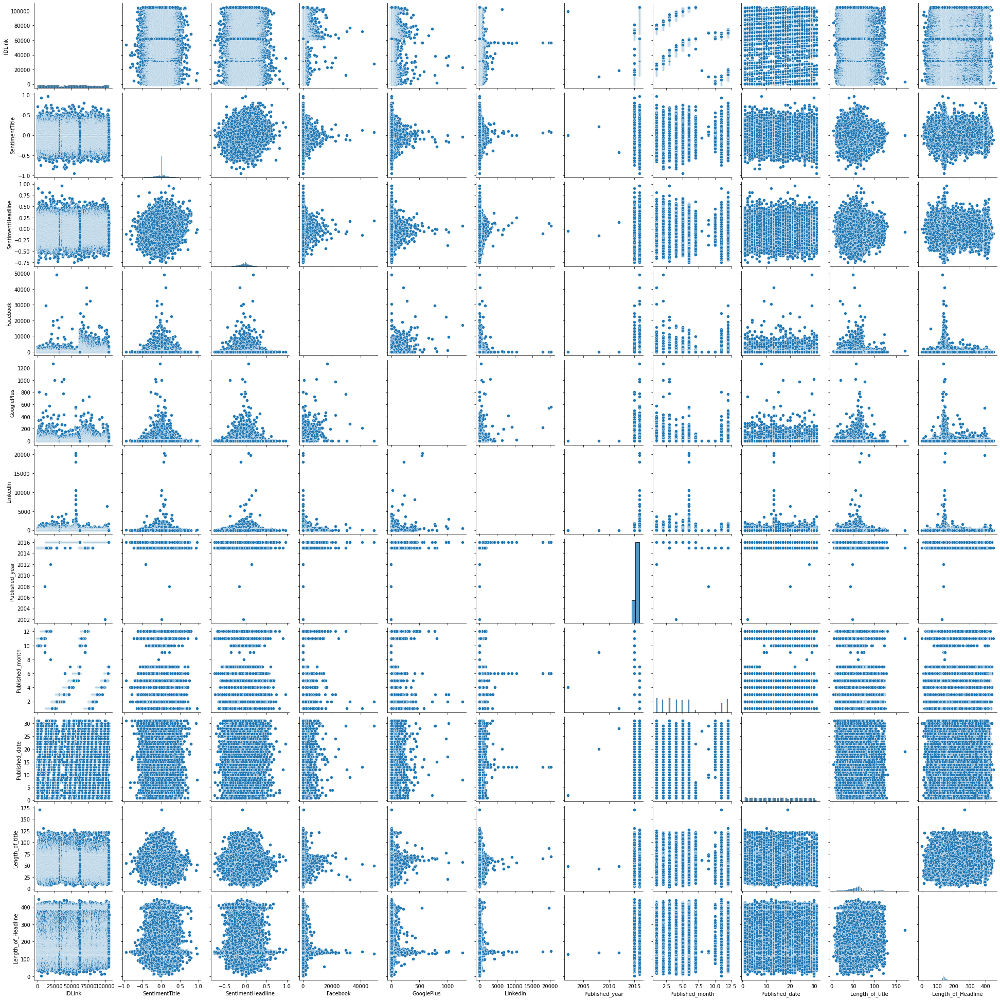

In [69]:
sns.pairplot(social_df,)

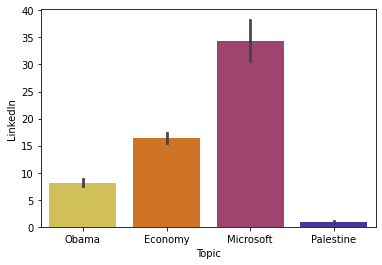

In [79]:
sns.barplot(y='LinkedIn',x='Topic',data=new_social_df,palette='CMRmap_r');

- These are the different topics discussed on LinkedIn and it can be seen that the discussion or likes can be more on Microsoft, Economy than on Palestine and Obama as it is the dominating topic of news published on this platform.

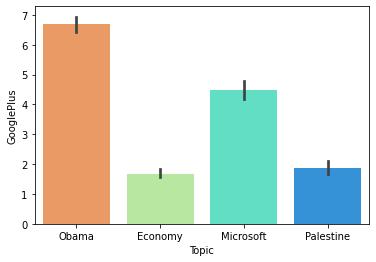

In [79]:
sns.barplot(y='GooglePlus',x='Topic',data=new_social_df,palette='rainbow_r');

- When it comes to discussions on GooglePlus there is a good amount of distribition of topics being discussed more than on Facebook and LinkedIn
- It can be seen that still there are more discussions happening on Obama and their things. Next on Microsoft,Palestine and Economy respectively.
- Here all the topics of news articles are published without anything being too less to be known or discussed on this platform.
- There are good number of news articles on all the topics eventhough still the imbalance in the topics exist with Obama news articles are published more on this platform also as on Facebook.

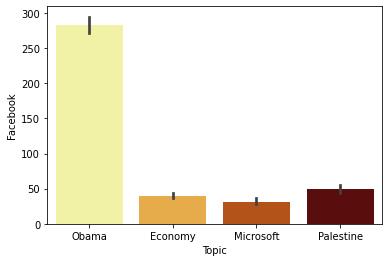

In [80]:
sns.barplot(y='Facebook',x='Topic',data=new_social_df,palette='afmhot_r');

- Even on Facebook the topic under discussion is dominated by Obama where most of them are discussing on how Obama has been dealing with the things and his way of things, what he is doing and so on. The others topics are leastly being occurred for discussions or other news is less published. Palestine,Economy and Microsoft news occur very rarely in this medium and also the likes will be less to it on Facebook.

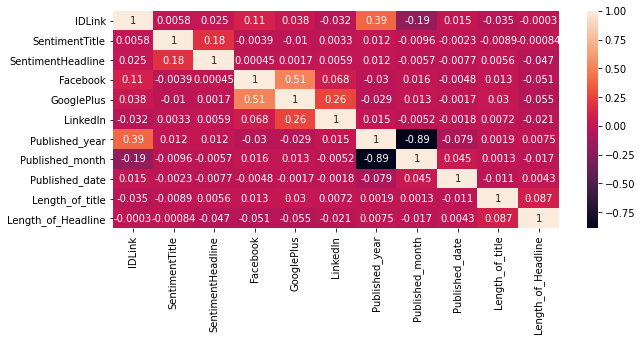

In [81]:
df_corr=social_df.corr()
plt.figure(figsize=(10,4))
sns.heatmap(df_corr,fmt='.2g',annot=True);

- The highly correlated variables for the dataset are Facebook and GooglePlus. Definitely I'm going take them seprately for further processing as they are different social media platforms which have to be predicted. Same with GooglePlus and LinkedIn. ID link and published are some other correlated varibales then IDLink is not going to be taken as feature for prediction or estimation of likes for the particular platform. 
- Now slightly correlated variables are Sentiment Title and Headline. Obviously like Title and Headlines are interlinked. Also Length of Title and Headline are showing some correlation. All the others are not much effected by correlation.

In [71]:
" ".join(str(t) for t in new_social_df['Cleaned_Title_and_Headline'])

'Obama Lays Wreath Arlington National Cemetery Obama Lays Wreath Arlington National Cemetery President Barack Obama laid wreath Tomb Unknowns honor Look Health Chinese Economy Tim Haywood investment director businessunit head fixed income Gam discusses China beige book state economy Nouriel Roubini Global Economy Back 2008 Nouriel Roubini NYU professor chairman Roubini Global Economics explains global economy isnt facing conditions Finland GDP Expands Q4 Finlands economy expanded marginally three months ended December contracting previous quarter preliminary figures Statistics Finland showed Monday Tourism govt spending buoys Thai economy January Tourism public spending continued boost economy January light contraction private consumption exports according Bank Thailand data Intellitec Solutions Host 13th Annual Spring Microsoft Dynamics User Group 100 attendees expected see latest version Microsoft Dynamics SL Dynamics GP PRWeb February 29 2016 Read full story httpwwwprwebcomreleases2

In [68]:
text = " ".join(str(t) for t in new_social_df['Cleaned_Title_and_Headline'])
# Create and generate a word cloud image:
wordcloud = WordCloud().generate(text)

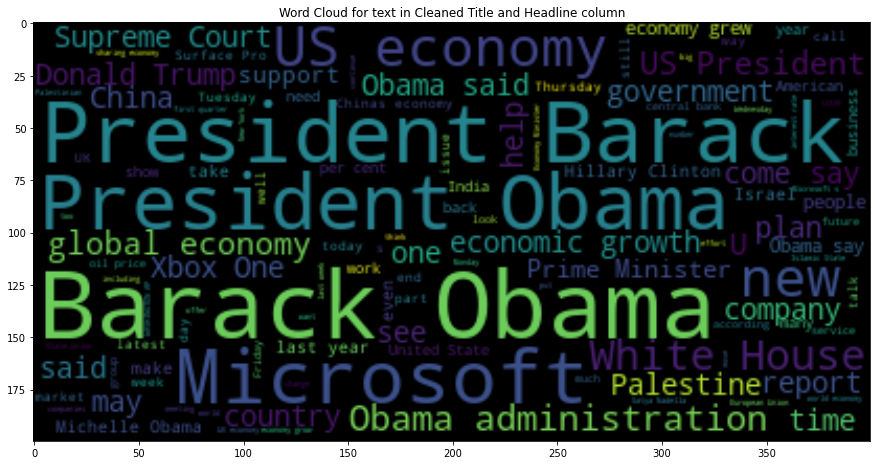

In [69]:
plt.figure(figsize=(15,10))
#plt.subplot(1,2,1)
# Display the generated image:
plt.title('Word Cloud for text in Cleaned Title and Headline column')
plt.imshow(wordcloud, interpolation='bilinear',cmap='YlOrBr_r')

- From the above plot we can see the different names present in the Cleaned Title and Headline column.
- The highlighted names tells the frequency of the words present in the data.
- The words which occurred mostly in Cleaned Title and Headline are Obama, Microsoft,economy, Palestine,US economy,President Obama,new,Report, China, global economy, President Barack, Barack Obama, White House, US President, Obama administration, new, US economy, global economy, Thursday, may, first, Supreme Court and Support etc.
- There are good number of important words to be noted. Nice!!!

<AxesSubplot:xlabel='SentimentHeadline', ylabel='Density'>

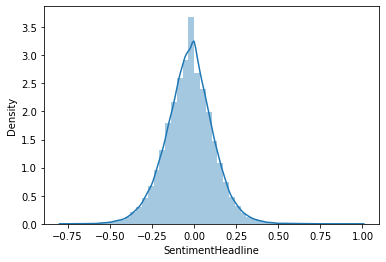

In [580]:
sns.distplot(social_df['SentimentHeadline'],)

<AxesSubplot:xlabel='SentimentTitle', ylabel='Density'>

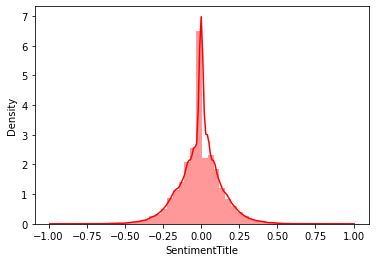

In [97]:
sns.distplot(social_df['SentimentTitle'],color='red')

<AxesSubplot:xlabel='Length_of_Headline', ylabel='Density'>

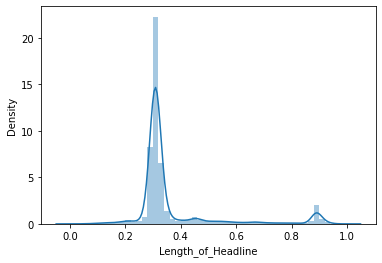

In [581]:
sns.distplot(title_norm_df['Length_of_Headline'])

<AxesSubplot:xlabel='Length_of_title', ylabel='Density'>

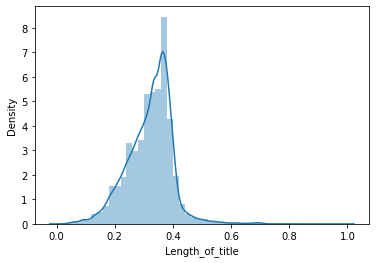

In [582]:
sns.distplot(title_norm_df['Length_of_title'])

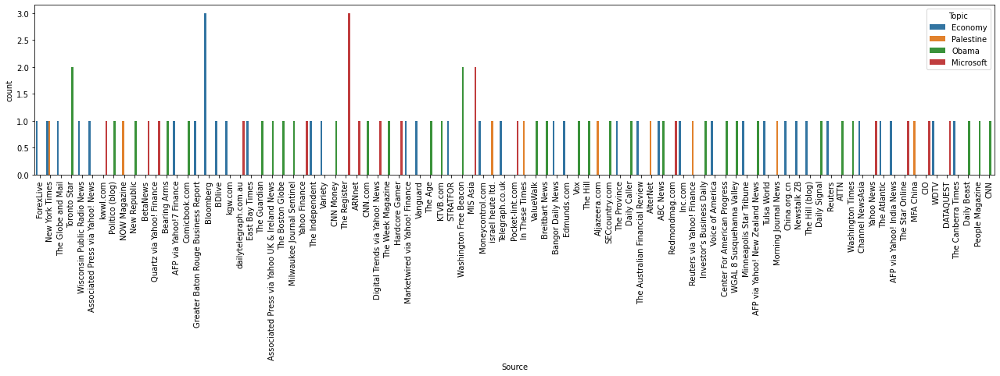

In [68]:
plt.figure(figsize=(22,4))
sns.countplot(x='Source',hue='Topic',data=social_df.sample(100));
plt.xticks(rotation='vertical');

- This is the sample data extracted from the population so that the plot can be clearly seen.
- Here it can that there are more news from the Sources Bloomberg, The Register, Washington free Beacon,MIS Asia and Toronto Stars than any other Source. Also Bloomberg has more Economy topic news; The Register,MIS Are has more news on Microsoft; Washington Beacon, Toronto Star has more news on Obama. 
- From this small sample distribution of news Sources and their topics discussed it can be see that there are more news on Economy, Microsoft, Obama than news on Palestine.

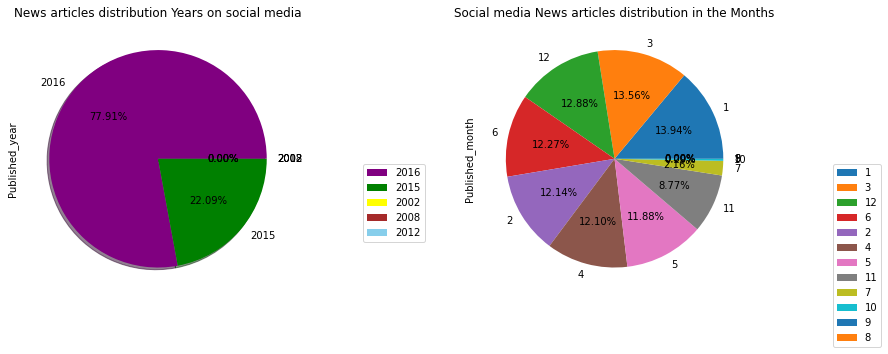

In [82]:
plt.subplot(1,2,1)
k=social_df['Published_year'].value_counts(sort=True);
colors = ["purple","green","yellow","brown","skyblue"]
#explode = (0.2,0)
k.plot(kind='pie',figsize=(15,5),legend=True,colors=colors,autopct='%1.2f%%', shadow=True, startangle=0,);
plt.title('News articles distribution Years on social media')
plt.legend(loc=0,bbox_to_anchor=(1.5,0.5));
plt.subplot(1,2,2);
k=social_df['Published_month'].value_counts();
k.plot(kind='pie',figsize=(15,5),legend=True,autopct='%1.2f%%');
plt.title('Social media News articles distribution in the Months')
plt.legend(loc=0,bbox_to_anchor=(1.5,0.5));

- It can be seen from the above plot that news articles on social media are more in the year 2016 and 2015 and very few in the other years 2002,2008,2012.
- From the month distributionin which articles are on social media, they are not much greater in any particular month almost all the month have equal news artilces being discussed with atleast 12% each month. There are few months in exception to 12% distribution of articles discussed on social media. They are in the months of July, August, September and October.

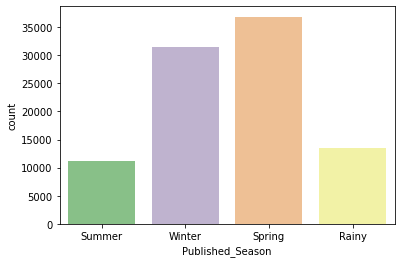

In [85]:
sns.countplot(x='Published_Season',data=cat_df,palette='Accent');

- This gives more information on how often the news articles are being discussed on social media.
- It says that there are these news on the four topics Obama, Economy, Microsoft and Palestine have more discussions, interactions and popular in the seasons Spring then in Winter followed by Rainy and Summer season.
- There are less discussions happened in Summer and highest likes or interactions have happened in Spring season.

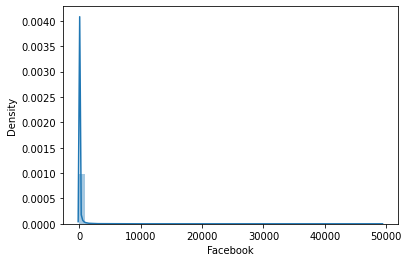

In [99]:
sns.distplot(social_df['Facebook']);

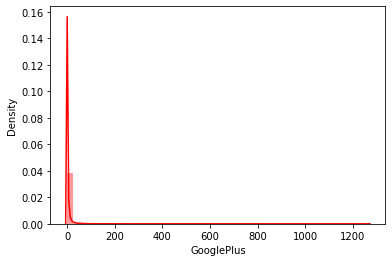

In [108]:
sns.distplot(social_df['GooglePlus'],color='red');

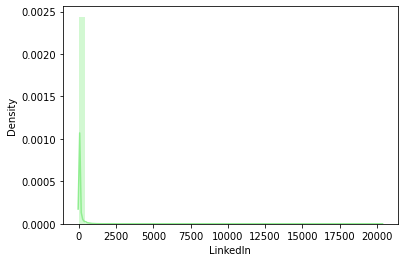

In [110]:
sns.distplot(social_df['LinkedIn'],color='lightgreen');

In [111]:
print("Skewness for Facebook: %f" % social_df['Facebook'].skew())
print("Kurtosis for Facebook: %f" % social_df['Facebook'].kurt())
print("Skewness for Googleplus: %f" % social_df['GooglePlus'].skew())
print("Kurtosis for Googleplus: %f" % social_df['GooglePlus'].kurt())
print("Skewness for Linkedin: %f" % social_df['LinkedIn'].skew())
print("Kurtosis for Linkedin: %f" % social_df['LinkedIn'].kurt())

Skewness for Facebook: 22.818079
Kurtosis for Facebook: 1028.248881
Skewness for Googleplus: 20.175085
Kurtosis for Googleplus: 779.311157
Skewness for Linkedin: 76.621203
Kurtosis for Linkedin: 8620.711834


- There are more data with less likes at one point as almost zero for all the social media platforms with peakedness at one point
- From the above plots it can be seen that likes are more for facebook and linkedin to a maximum of 50000 and 21000 respectively whereas for googleplus it is only upto 1300.
- There are highest likes generated for Facebook and least for GooglePlus.
- All the social media platforms popularity follows right tail distribution. 

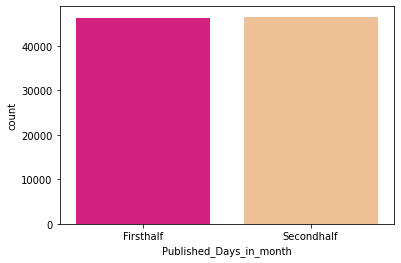

In [105]:
sns.countplot(x='Published_Days_in_month',data=cat_df,palette='Accent_r');

- It can be seen that the news articles are being discussed and liked equally on first half and second half of the months

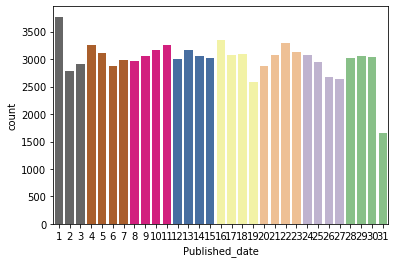

In [106]:
sns.countplot(x='Published_date',data=social_df,palette='Accent_r');

- It can be seen that there are more news artciles popular and liked on 1st day of the month than any other data and least on the last day or on the 31st date of the months. 

## Feature engineering and selection
- Making a copy from previously processed dataframe so that you can store the previous process so that it can be used when required. Creating a copy for further processing.
- Creating new columns from existing features in the dataset like from date column,sentiment scores.
- Creating dummies for categorical columns and normmalizing the numerical columns.
- Combining all the created columns with previously existed dataframe and dropping unncessary features from the dataframe.
- Apply SVD for further feature selection of important features for model building which captures most of the variance in the data so that good predictions are obtained.

In [65]:
new_social_df1=new_social_df.copy()

In [66]:
new_social_df1.drop(columns=['Title','Headline','IDLink','Cleaned_Title_and_Headline'],axis=1,inplace=True)
ic(new_social_df1.shape);

ic| new_social_df1.shape: (92945, 1225)


In [67]:
new_social_df1.columns

Index(['abbas', 'able', 'access', 'according', 'across', 'act', 'action',
       'actions', 'activity', 'actually',
       ...
       'SentimentTitle', 'SentimentHeadline', 'Facebook', 'GooglePlus',
       'LinkedIn', 'Published_year', 'Published_month', 'Published_date',
       'Length_of_title', 'Length_of_Headline'],
      dtype='object', length=1225)

In [68]:
new_social_df1.shape[0]

92945

In [69]:
type(new_social_df1['Published_month'][12])

numpy.int64

In [70]:
new_social_df1.loc[12,'Published_month']

3

In [71]:
# Adding a new column time of season 
for i in range(new_social_df1.shape[0]):
    if (new_social_df1.loc[i,'Published_month']>=1.0 and new_social_df1.loc[i,'Published_month']<=3.0):
        new_social_df1.loc[i,'Published_Season']='Spring'
    elif (new_social_df1.loc[i,'Published_month']>3.0 and new_social_df1.loc[i,'Published_month']<5.0):
        new_social_df1.loc[i,'Published_Season']='Summer'
    elif (new_social_df1.loc[i,'Published_month']>5.0 and new_social_df1.loc[i,'Published_month']<=8.0):
        new_social_df1.loc[i,'Published_Season']='Rainy'
    else:
        new_social_df1.loc[i,'Published_Season']='Winter'

In [72]:
# Creating a new column MonDays from Days column 
for i in range(new_social_df1.shape[0]):
    if (new_social_df1.loc[i,'Published_date']>=1.0 and new_social_df1.loc[i,'Published_date']<=15.0):
        new_social_df1.loc[i,'Published_Days_in_month']='Firsthalf'
    else:
        new_social_df1.loc[i,'Published_Days_in_month']='Secondhalf'

In [73]:
new_social_df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1227 entries, abbas to Published_Days_in_month
dtypes: float64(1215), int64(8), object(4)
memory usage: 870.1+ MB


In [74]:
new_social_df1.tail(4)

,abbas,able,access,according,across,act,action,actions,activity,actually,...,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Published_Season,Published_Days_in_month
92941,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-1,0,1,2016,7,7,65,131,Rainy,Firsthalf
92942,0.0,0.0,0.0,0.188257,0.0,0.0,0.0,0.0,0.0,0.0,...,5,1,0,2016,7,7,67,142,Rainy,Firsthalf
92943,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,2016,7,7,52,141,Rainy,Firsthalf
92944,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-1,1,0,2016,7,7,63,135,Rainy,Firsthalf


In [75]:
#function to convert sentiment score to positive or negative or neutral review 
#def score_to_string(sentiment):
 #   if (sentiment > -0.5) & (sentiment < 0.0):
  #      return "Negative"
  #  elif (sentiment < -0.5) & (sentiment < 0.0):
  #      return "Extremely negative"
  #  elif (sentiment > 0.5) & (sentiment > 0.0):
  #      return "Extremely positive"
 #   elif (sentiment < 0.5) & (sentiment > 0.0):
  #      return "Positive"
  #  else:
  #      return "Neutral"

In [76]:
#new_social_df1['Sentiment_in_title']=new_social_df1['SentimentTitle'].apply(score_to_string)
#new_social_df1['Sentiment_in_headline']=new_social_df1['SentimentHeadline'].apply(score_to_string)

In [77]:
new_social_df1.tail(4)

,abbas,able,access,according,across,act,action,actions,activity,actually,...,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_date,Length_of_title,Length_of_Headline,Published_Season,Published_Days_in_month
92941,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-1,0,1,2016,7,7,65,131,Rainy,Firsthalf
92942,0.0,0.0,0.0,0.188257,0.0,0.0,0.0,0.0,0.0,0.0,...,5,1,0,2016,7,7,67,142,Rainy,Firsthalf
92943,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,2016,7,7,52,141,Rainy,Firsthalf
92944,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,-1,1,0,2016,7,7,63,135,Rainy,Firsthalf


In [78]:
new_social_df2=new_social_df1.copy()

In [79]:
new_social_df2.drop(columns=['Published_date'],axis=1,inplace=True)
#sentiment title and headline not dropped

In [80]:
new_social_df2.shape

(92945, 1226)

In [81]:
new_social_df2['Published_Season'].value_counts()

Spring    36845
Winter    31439
Rainy     13416
Summer    11245
Name: Published_Season, dtype: int64

In [82]:
#new_social_df2['Sentiment_in_title']=new_social_df2['Sentiment_in_title'].map({'Positive':1,'Extremely positive':2,'Negative':\
 #                                                                             -1,'Extremely negative':-2,'Neutral':0},)

In [83]:
#new_social_df2['Sentiment_in_headline']=new_social_df2['Sentiment_in_headline'].map({'Positive':1,'Extremely positive':2,'Negative':\
 #                                                                             -1,'Extremely negative':-2,'Neutral':0},)

In [84]:
new_social_df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1226 entries, abbas to Published_Days_in_month
dtypes: float64(1215), int64(7), object(4)
memory usage: 869.4+ MB


In [85]:
#unique values in Sources
len(new_social_df2['Source'].unique())

5755

In [86]:
new_social_df1['Published_year'].value_counts()

2016    72411
2015    20531
2002        1
2008        1
2012        1
Name: Published_year, dtype: int64

In [87]:
new_social_df2['Published_year']=new_social_df2['Published_year'].astype(str)
new_social_df2['Published_month']=new_social_df2['Published_month'].astype(str)
new_social_df2['Published_Season']=new_social_df2['Published_Season'].astype(str)
new_social_df2['Published_Days_in_month']=new_social_df2['Published_Days_in_month'].astype(str)
#new_social_df2['Sentiment_in_title']=new_social_df2['Sentiment_in_title'].astype(str)
#new_social_df2['Sentiment_in_headline']=new_social_df2['Sentiment_in_headline'].astype(str)

In [88]:
scaling_cols=['Length_of_title','Length_of_Headline','SentimentTitle','SentimentHeadline']
scaler=MinMaxScaler()
scaled_array=scaler.fit_transform(social_df[scaling_cols])
ic(scaled_array);
title_norm_df=pd.DataFrame(scaled_array,columns=scaling_cols,index=social_df.index)
title_norm_df.head(3)

ic| scaled_array: array([[0.26506024, 0.28314607, 0.49695274, 0.4081981 ],
                         [0.23493976, 0.30561798, 0.605854  , 0.34826737],
                         [0.26506024, 0.30561798, 0.27468438, 0.52043385],
                         ...,
                         [0.37951807, 0.31685393, 0.6494145 , 0.35793643],
                         [0.28915663, 0.31460674, 0.56048171, 0.49285297],
                         [0.35542169, 0.3011236 , 0.49695274, 0.47090139]])


,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline
0,0.26506,0.283146,0.496953,0.408198
1,0.23494,0.305618,0.605854,0.348267
2,0.26506,0.305618,0.274684,0.520434


In [89]:
cat_df=pd.concat([title_norm_df,new_social_df2.drop(columns=['Length_of_title','Length_of_Headline','SentimentTitle','SentimentHeadline'],axis=1)],axis=1,)
cat_df.head(4)

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.265060,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.234940,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.265060,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf
3,0.126506,0.393258,0.496953,0.454338,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,RTT News,Economy,-1,-1,-1,2015,3,Spring,Firsthalf


In [90]:
cat_df.shape

(92945, 1226)

In [91]:
#cat_df.drop(columns=['IDLink','Title','Headline','Cleaned_Title_and_Headline'],axis=1,inplace=True)

In [92]:
cat_df.head()

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.265060,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.234940,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.265060,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf
3,0.126506,0.393258,0.496953,0.454338,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,RTT News,Economy,-1,-1,-1,2015,3,Spring,Firsthalf
4,0.289157,0.382022,0.496953,0.521207,0.0,0.0,0.0,0.175485,0.0,0.0,...,0.0,The Nation - Thailand&#39;s English news,Economy,-1,-1,-1,2015,3,Spring,Firsthalf


In [93]:
cat_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1226 entries, Length_of_title to Published_Days_in_month
dtypes: float64(1217), int64(3), object(6)
memory usage: 869.4+ MB


In [94]:
cat_df.head(3)

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.26506,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.23494,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.26506,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf


In [95]:
Pub_year_df=pd.get_dummies(data=new_social_df2['Published_year'],drop_first=True,)
Pub_month_df=pd.get_dummies(data=new_social_df2['Published_month'],drop_first=True)
Pub_season_df=pd.get_dummies(data=new_social_df2['Published_Season'],drop_first=True)
Pub_days_df=pd.get_dummies(data=new_social_df2['Published_Days_in_month'],drop_first=True)
Topic_df=pd.get_dummies(data=new_social_df2['Topic'],drop_first=True)

In [96]:
Pub_days_df.tail(3)

,Secondhalf
92942,0
92943,0
92944,0


In [97]:
Topic_df.tail(2)

,Microsoft,Obama,Palestine
92943,0,0,1
92944,1,0,0


In [98]:
new_social_df3=pd.concat([Pub_year_df,Pub_season_df,Pub_month_df,Pub_days_df,Topic_df,title_norm_df,new_social_df2.drop\
                         (columns=['Length_of_title','Length_of_Headline','SentimentTitle','SentimentHeadline'],axis=1)],axis=1)
new_social_df3.head(3)

,2008,2012,2015,2016,Spring,Summer,Winter,10,11,12,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0,0,0,0,0,1,0,0,0,0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,1,0,0,0,0,0,1,0,0,0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0,1,0,0,1,0,0,0,0,0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf


In [99]:
new_social_df3['SentimentTitle']

0        0.496953
1        0.605854
2        0.274684
3        0.496953
4        0.496953
           ...   
92940    0.551465
92941    0.534691
92942    0.649414
92943    0.560482
92944    0.496953
Name: SentimentTitle, Length: 92945, dtype: float64

In [100]:
new_social_df3.shape

(92945, 1248)

In [101]:
#new_social_df3=pd.concat([new_social_df3,Topic_df],axis=1)

In [102]:
new_social_df3.shape

(92945, 1248)

In [103]:
new_social_df3.keys()

Index(['2008', '2012', '2015', '2016', 'Spring', 'Summer', 'Winter', '10',
       '11', '12',
       ...
       'youre', 'Source', 'Topic', 'Facebook', 'GooglePlus', 'LinkedIn',
       'Published_year', 'Published_month', 'Published_Season',
       'Published_Days_in_month'],
      dtype='object', length=1248)

In [104]:
new_social_df3.drop(columns=['Published_year','Published_month','Published_Season','Published_Days_in_month','Topic','Source'],axis=1,inplace=True)

In [105]:
new_social_df2['Source']

0                                       USA TODAY
1                                       Bloomberg
2                                       Bloomberg
3                                        RTT News
4        The Nation - Thailand&#39;s English news
                           ...                   
92940                                 MarketWatch
92941                                        TASS
92942                                Daily Caller
92943                                Ahram Online
92944                              East Bay Times
Name: Source, Length: 92945, dtype: object

In [106]:
new_social_df3.shape

(92945, 1242)

In [107]:
new_social_df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1242 entries, 2008 to LinkedIn
dtypes: float64(1217), int64(3), uint8(22)
memory usage: 867.1 MB


In [108]:
#new_social_df4=pd.concat([title_norm_df,new_social_df3.drop(columns=['Length_of_title','Length_of_Headline','SentimentTitle','SentimentHeadline','Source'],axis=1)],axis=1,)
new_social_df4=new_social_df3.copy()
new_social_df4.head(4)

,2008,2012,2015,2016,Spring,Summer,Winter,10,11,12,...,year,years,yesterday,yet,york,young,youre,Facebook,GooglePlus,LinkedIn
0,0,0,0,0,0,1,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
1,1,0,0,0,0,0,1,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
2,0,1,0,0,1,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
3,0,0,1,0,1,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1


In [109]:
new_social_df4.shape

(92945, 1242)

In [110]:
new_social_df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92945 entries, 0 to 92944
Columns: 1242 entries, 2008 to LinkedIn
dtypes: float64(1217), int64(3), uint8(22)
memory usage: 867.1 MB


In [111]:
new_social_df4.describe()

,2008,2012,2015,2016,Spring,Summer,Winter,10,11,12,...,year,years,yesterday,yet,york,young,youre,Facebook,GooglePlus,LinkedIn
count,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,...,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000,92945.000000
mean,0.000011,0.000011,0.220894,0.779074,0.396417,0.120986,0.338254,0.002916,0.087740,0.128775,...,0.012151,0.008705,0.001498,0.002490,0.002476,0.001864,0.001233,113.497897,3.901124,16.600882
std,0.003280,0.003280,0.414851,0.414873,0.489156,0.326112,0.473118,0.053919,0.282918,0.334953,...,0.050422,0.044045,0.022177,0.027359,0.027928,0.026559,0.020759,621.120839,18.520443,154.700274
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000
25%,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,33.000000,2.000000,4.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.718157,0.759007,0.671805,0.831602,0.779622,0.892013,0.769389,49211.000000,1267.000000,20341.000000


In [112]:
new_social_df5=new_social_df4.drop(columns=['LinkedIn','GooglePlus','Facebook'],axis=1)

In [113]:
new_social_df5.shape

(92945, 1239)

### SVD used for dimensionality reduction

In [118]:
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD( n_components = 1238, random_state=40 )
trsvd = svd.fit_transform( new_social_df5)
cumVarianceExplained = np.cumsum( svd.explained_variance_ratio_ )

In [119]:
svd

TruncatedSVD(n_components=1238, random_state=40)

In [120]:
trsvd

array([[ 8.14532431e-01, -8.09778621e-05,  1.06771915e+00, ...,
         6.97373076e-02,  3.10959857e-01,  2.52835602e-15],
       [ 1.00241569e+00,  8.14259562e-01, -1.68031506e-02, ...,
         6.49098176e-01, -3.73496122e-02,  2.36073301e-14],
       [ 1.04422366e+00, -1.06538761e-01, -5.72574001e-01, ...,
        -2.16965398e-01, -3.55370422e-02, -2.95849162e-15],
       ...,
       [ 1.09290171e+00, -2.69255151e-01,  2.44352164e-01, ...,
         5.64170672e-06, -1.41858949e-05,  3.84266300e-15],
       [ 1.08434298e+00, -2.71656244e-01,  2.47479648e-01, ...,
         9.33061957e-05, -3.70547879e-06,  2.78889536e-15],
       [ 1.17368494e+00, -2.32960052e-01,  2.27398507e-01, ...,
        -7.88008561e-06,  3.76177306e-06,  2.04256773e-15]])

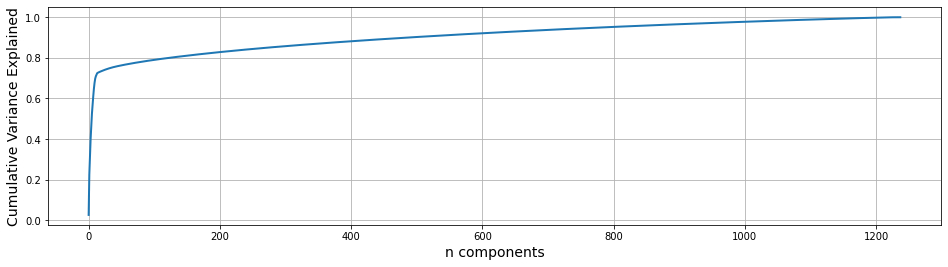

In [121]:
plt.figure( figsize=(16, 4))
plt.plot( cumVarianceExplained, linewidth = 2 )
plt.grid()
plt.xlabel('n components',size=14)
plt.ylabel('Cumulative Variance Explained',size=14)
plt.show()

In [122]:
len(svd.components_)

1238

In [123]:
best_features=[]
new_features = [i for i in new_social_df5.columns]
best_features = [new_features[i] for i in svd.components_[0].argsort()[::-1]]

In [124]:
best_features[0:10]

['2016',
 'Secondhalf',
 'SentimentTitle',
 'Spring',
 'SentimentHeadline',
 'Length_of_Headline',
 'Obama',
 'Length_of_title',
 'Winter',
 'Microsoft']

In [125]:
best_features_sort=pd.DataFrame(data=best_features,columns=['Features'])

In [126]:
best_features_sort.head()

,Features
0,2016
1,Secondhalf
2,SentimentTitle
3,Spring
4,SentimentHeadline


In [127]:
best_features_sort.shape

(1239, 1)

In [128]:
best_feat=[]
best_feat=best_features[0:900]
best_feat.extend(['LinkedIn','GooglePlus','Facebook'])
len(best_feat)

903

In [129]:
new_social_df4.shape

(92945, 1242)

In [130]:
new_social_df5.shape

(92945, 1239)

In [131]:
new_social_df5_feat=new_social_df4[best_feat]

In [132]:
# Dataframe formed after applying SVD
new_social_df5_feat.tail()

,2016,Secondhalf,SentimentTitle,Spring,SentimentHeadline,Length_of_Headline,Obama,Length_of_title,Winter,Microsoft,...,expectations,vs,remarks,japanese,gives,muslim,decline,LinkedIn,GooglePlus,Facebook
92940,1,0,0.551465,0,0.465314,0.310112,0,0.379518,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5,3,-1
92941,1,0,0.534691,0,0.439185,0.292135,0,0.367470,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0,-1
92942,1,0,0.649414,0,0.357936,0.316854,0,0.379518,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1,5
92943,1,0,0.560482,0,0.492853,0.314607,0,0.289157,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
92944,1,0,0.496953,0,0.470901,0.301124,0,0.355422,0,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,1,-1


In [133]:
# Shape of dataframe after applying SVD
new_social_df5_feat.shape

(92945, 903)

In [134]:
fb_df=new_social_df5_feat.drop(columns=['LinkedIn','GooglePlus'],axis=1,)
googlep_df=new_social_df5_feat.drop(columns=['Facebook','LinkedIn'],axis=1,)
linkedin_df=new_social_df5_feat.drop(columns=['Facebook','GooglePlus'],axis=1,)

In [135]:
# Facebook analysis dataframe
fb_df.head()

,2016,Secondhalf,SentimentTitle,Spring,SentimentHeadline,Length_of_Headline,Obama,Length_of_title,Winter,Microsoft,...,search,israels,expectations,vs,remarks,japanese,gives,muslim,decline,Facebook
0,0,0,0.496953,0,0.408198,0.283146,1,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
1,0,1,0.605854,0,0.348267,0.305618,0,0.234940,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
2,0,1,0.274684,1,0.520434,0.305618,0,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
3,0,0,0.496953,1,0.454338,0.393258,0,0.126506,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
4,0,0,0.496953,1,0.521207,0.382022,0,0.289157,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1


In [136]:
googlep_df.head()

,2016,Secondhalf,SentimentTitle,Spring,SentimentHeadline,Length_of_Headline,Obama,Length_of_title,Winter,Microsoft,...,search,israels,expectations,vs,remarks,japanese,gives,muslim,decline,GooglePlus
0,0,0,0.496953,0,0.408198,0.283146,1,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
1,0,1,0.605854,0,0.348267,0.305618,0,0.234940,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
2,0,1,0.274684,1,0.520434,0.305618,0,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
3,0,0,0.496953,1,0.454338,0.393258,0,0.126506,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
4,0,0,0.496953,1,0.521207,0.382022,0,0.289157,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1


In [137]:
linkedin_df.head()

,2016,Secondhalf,SentimentTitle,Spring,SentimentHeadline,Length_of_Headline,Obama,Length_of_title,Winter,Microsoft,...,search,israels,expectations,vs,remarks,japanese,gives,muslim,decline,LinkedIn
0,0,0,0.496953,0,0.408198,0.283146,1,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
1,0,1,0.605854,0,0.348267,0.305618,0,0.234940,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
2,0,1,0.274684,1,0.520434,0.305618,0,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
3,0,0,0.496953,1,0.454338,0.393258,0,0.126506,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1
4,0,0,0.496953,1,0.521207,0.382022,0,0.289157,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1


In [138]:
new_social_df4.tail(4)

,2008,2012,2015,2016,Spring,Summer,Winter,10,11,12,...,year,years,yesterday,yet,york,young,youre,Facebook,GooglePlus,LinkedIn
92941,0,0,0,1,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,0,1
92942,0,0,0,1,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5,1,0
92943,0,0,0,1,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
92944,0,0,0,1,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,1,0


In [139]:
new_social_df5_feat.head()

,2016,Secondhalf,SentimentTitle,Spring,SentimentHeadline,Length_of_Headline,Obama,Length_of_title,Winter,Microsoft,...,expectations,vs,remarks,japanese,gives,muslim,decline,LinkedIn,GooglePlus,Facebook
0,0,0,0.496953,0,0.408198,0.283146,1,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
1,0,1,0.605854,0,0.348267,0.305618,0,0.234940,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
2,0,1,0.274684,1,0.520434,0.305618,0,0.265060,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
3,0,0,0.496953,1,0.454338,0.393258,0,0.126506,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1
4,0,0,0.496953,1,0.521207,0.382022,0,0.289157,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1,-1,-1


In [98]:
cat_df.head(3)

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.26506,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.23494,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.26506,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf


### Train test split for different social media

In [141]:
fbx1=fb_df.drop('Facebook',axis=1)
fby1=fb_df['Facebook']
googlex1=googlep_df.drop('GooglePlus',axis=1)
googley1=googlep_df['GooglePlus']
linkedx1=linkedin_df.drop('LinkedIn',axis=1)
linkedy1=linkedin_df['LinkedIn']

In [142]:
fbx1_train,fbx1_test,fby1_train,fby1_test=train_test_split(fbx1,fby1,test_size=0.3,random_state=34)
ic(fbx1_train.shape,fbx1_test.shape,fby1_train.shape,fby1_test.shape);

ic| fbx1_train.shape: (65061, 900)
    fbx1_test.shape: (27884, 900)
    fby1_train.shape: (65061,)
    fby1_test.shape: (27884,)


In [143]:
len(fby1.value_counts())

2528

In [144]:
googlex1_train,googlex1_test,googley1_train,googley1_test=train_test_split(googlex1,googley1,test_size=0.3,random_state=45)
ic(googlex1_train.shape,googley1_train.shape,googlex1_test.shape,googley1_test.shape);

ic| googlex1_train.shape: (65061, 900)
    googley1_train.shape: (65061,)
    googlex1_test.shape: (27884, 900)
    googley1_test.shape: (27884,)


In [145]:
linkedx1_train,linkedx1_test,linkedy1_train,linkedy1_test=train_test_split(linkedx1,linkedy1,test_size=0.3,random_state=679)
ic(linkedx1_train.shape,linkedy1_train.shape,linkedx1_test.shape,linkedy1_test.shape);

ic| linkedx1_train.shape: (65061, 900)
    linkedy1_train.shape: (65061,)
    linkedx1_test.shape: (27884, 900)
    linkedy1_test.shape: (27884,)


### Cat model train, test split

In [146]:
cat_df.head(3)

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.26506,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.23494,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.26506,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf


In [147]:
cat_df.columns

Index(['Length_of_title', 'Length_of_Headline', 'SentimentTitle',
       'SentimentHeadline', 'abbas', 'able', 'access', 'according', 'across',
       'act',
       ...
       'youre', 'Source', 'Topic', 'Facebook', 'GooglePlus', 'LinkedIn',
       'Published_year', 'Published_month', 'Published_Season',
       'Published_Days_in_month'],
      dtype='object', length=1226)

In [148]:
cat_df.shape

(92945, 1226)

In [99]:
cat_feat=['Topic','Source','Published_year','Published_month','Published_Days_in_month','Published_Season']
#text_feat=['Cleaned_Title_and_Headline']
num_feat=['Length_of_title', 'Length_of_Headline', 'SentimentTitle','SentimentHeadline']

In [100]:
cat_model_feat=list(cat_df.drop(columns=['Facebook','GooglePlus','LinkedIn'],axis=1).columns)
len(cat_model_feat)

1223

In [101]:
cat_fbx1=cat_df.drop(columns=['Facebook','GooglePlus','LinkedIn'],axis=1)
cat_fby1=cat_df['Facebook']
cat_gox1=cat_df.drop(columns=['Facebook','GooglePlus','LinkedIn'],axis=1)
cat_goy1=cat_df['GooglePlus']
cat_lnx1=cat_df.drop(columns=['Facebook','GooglePlus','LinkedIn'],axis=1)
cat_lny1=cat_df['LinkedIn']

In [102]:
cat_fbx1.tail(3)

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,yet,york,young,youre,Source,Topic,Published_year,Published_month,Published_Season,Published_Days_in_month
92942,0.379518,0.316854,0.649414,0.357936,0.0,0.0,0.0,0.188257,0.0,0.0,...,0.0,0.0,0.0,0.0,Daily Caller,Palestine,2016,7,Rainy,Firsthalf
92943,0.289157,0.314607,0.560482,0.492853,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,Ahram Online,Palestine,2016,7,Rainy,Firsthalf
92944,0.355422,0.301124,0.496953,0.470901,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,East Bay Times,Microsoft,2016,7,Rainy,Firsthalf


In [103]:
cat_fbx1_train,cat_fbx1_test,cat_fby1_train,cat_fby1_test=train_test_split(cat_fbx1,cat_fby1,test_size=0.3,random_state=34)
ic(cat_fbx1_train.shape,cat_fbx1_test.shape,cat_fby1_train.shape,cat_fby1_test.shape);

ic| cat_fbx1_train.shape: (65061, 1223)
    cat_fbx1_test.shape: (27884, 1223)
    cat_fby1_train.shape: (65061,)
    cat_fby1_test.shape: (27884,)


In [104]:
cat_gox1_train,cat_gox1_test,cat_goy1_train,cat_goy1_test=train_test_split(cat_gox1,cat_goy1,test_size=0.3,random_state=45)
ic(cat_gox1_train.shape,cat_goy1_train.shape,cat_gox1_test.shape,cat_goy1_test.shape);

ic| cat_gox1_train.shape: (65061, 1223)
    cat_goy1_train.shape: (65061,)
    cat_gox1_test.shape: (27884, 1223)
    cat_goy1_test.shape: (27884,)


In [105]:
cat_lnx1_train,cat_lnx1_test,cat_lny1_train,cat_lny1_test=train_test_split(cat_lnx1,cat_lny1,test_size=0.3,random_state=679)
ic(cat_lnx1_train.shape,cat_lny1_train.shape,cat_lnx1_test.shape,cat_lny1_test.shape);

ic| cat_lnx1_train.shape: (65061, 1223)
    cat_lny1_train.shape: (65061,)
    cat_lnx1_test.shape: (27884, 1223)
    cat_lny1_test.shape: (27884,)


### Model building

In [106]:
def rmse(y_test,pred):
    rmse=np.sqrt(mean_squared_error(y_test,pred))
    return rmse

In [107]:
def mape(y_true, y_pred):
    try:
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100 
    except FloatingPointError :
        return 'not a number'

In [108]:
c=0
try:
    x=1/c
    print(x)    
except ZeroDivisionError:
    print('not a no.')


not a no.


In [109]:
def adj_r_sq(x,y,r2):
    '''
    Returns a computed Adjusted R-Squared Coefficient.
    
    Parameters
    ----------
    X : Pandas DataFrame
        A pandas DataFrame including all the independant variables. Could be a series if there is only one predictor.
        
    Y : Pandas DataFrame or Series
        Labels or response variables 'Y'.
        
    r2 : float
        R-Squared Coefficient
    '''
    n = len(y)
    p = x.shape[1]
    adj_r = 1 - ((1 - r2) * (n - 1)) / (n - p - 1)

    return adj_r

In [151]:
#def rmsle(y_true,y_pred):
 #   rmsle=np.sqrt(mean_squared_log_error(y_true,y_pred))
  #  return rmsle
# cannot calculate when target contains negative number

#### 1. Linear Regression

In [152]:
# Linear Regression for Facebook predictions
fb_lr_model=LinearRegression()
fb_lr_model.fit(fbx1_train,fby1_train)
fb_lr_pred=fb_lr_model.predict(fbx1_test)
ic(fb_lr_pred);

ic| fb_lr_pred: array([ 203.15625  , -113.609375 ,  500.6171875, ...,  297.640625 ,
                         14.4921875,  -26.765625 ])


In [153]:
ic(rmse(fby1_test,fb_lr_pred))
ic(mape(fby1_test,fb_lr_pred))
ic(r2_score(fby1_test,fb_lr_pred));

ic| rmse(fby1_test,fb_lr_pred): 362166037576.12274
ic| mape(fby1_test,fb_lr_pred): inf
ic| r2_score(fby1_test,fb_lr_pred): -3.3996013373823443e+17


In [154]:
ic(adj_r_sq(fbx1_test,fby1_test,-3.3996013373823443e+17));

ic| adj_r_sq(fbx1_test,fby1_test,-3.3996013373823443e+17): -3.526060487677414e+17


- Linear Regression model assumes linearity with the target variable and other assumptions which doesn't match to this dataset so there is a large variation and high error rate. Also the r2_score is very low indicating that the amount of variance that can be predicted with this model is so less. Even the r2_score, adj_r2_score is very low and is in negative. So this model is not good for prediction of news popularity in social media platforms.

In [155]:
#Linear regression for google predictions
go_lr_model=LinearRegression()
go_lr_model.fit(googlex1_train,googley1_train)
go_lr_pred=go_lr_model.predict(googlex1_test)
ic(go_lr_pred);

ic| go_lr_pred: array([2.28129573, 2.90356694, 8.53048988, ..., 9.72854416, 4.77866232,
                       1.91275449])


In [156]:
ic(rmse(googley1_test,go_lr_pred))
ic(mape(googley1_test,go_lr_pred))
ic(r2_score(googley1_test,go_lr_pred));

ic| rmse(googley1_test,go_lr_pred): 20.264388813788397
ic| mape(googley1_test,go_lr_pred): inf
ic| r2_score(googley1_test,go_lr_pred): 0.02484135609036131


In [157]:
ic(adj_r_sq(googlex1_test,googley1_test,0.02484135609036131));

ic| adj_r_sq(googlex1_test,googley1_test,0.02484135609036131): -0.011432818812351808


In [158]:
# Linear regression for linkedin predictions
ln_lr_model=LinearRegression()
ln_lr_model.fit(linkedx1_train,linkedy1_train)
ln_lr_pred=ln_lr_model.predict(linkedx1_test)
ic(ln_lr_pred);

ic| ln_lr_pred: array([ -4.91847933, 147.8336287 ,  34.50355854, ...,  14.40501046,
                         2.40509654,  15.12017873])


In [159]:
ic(rmse(linkedy1_test,ln_lr_pred))
ic(mape(linkedy1_test,ln_lr_pred))
ic(r2_score(linkedy1_test,ln_lr_pred));

ic| rmse(linkedy1_test,ln_lr_pred): 129.18347926434433
ic| mape(linkedy1_test,ln_lr_pred): inf
ic| r2_score(linkedy1_test,ln_lr_pred): 0.04974747158437831


In [161]:
ic(adj_r_sq(linkedx1_test,linkedy1_test,0.04974747158437831));

ic| adj_r_sq(linkedx1_test,linkedy1_test,0.04974747158437831): 0.014399760078384838


#### 2. Decision Tree Regressor

In [162]:
# Decision tree Regressor predictions for facebook
fb_dt_model = DecisionTreeRegressor(random_state=526)
fb_dt_model.fit(fbx1_train,fby1_train)
fb_dt_pred=fb_dt_model.predict(fbx1_test)
ic(fb_dt_pred);

ic| fb_dt_pred: array([0., 3., 7., ..., 0., 0., 0.])


In [163]:
ic(rmse(fby1_test,fb_dt_pred))
ic(mape(fby1_test,fb_dt_pred))
ic(r2_score(fby1_test,fb_dt_pred));

ic| rmse(fby1_test,fb_dt_pred): 765.7605194857048
ic| mape(fby1_test,fb_dt_pred): nan
ic| r2_score(fby1_test,fb_dt_pred): -0.5198421735123882


In [152]:
ic(adj_r_sq(fbx1_test,fby1_test,-0.5198421735123882));

ic| adj_r_sq(fbx1_test,fby1_test,-0.5198421735123882): -0.5763776112802113


In [164]:
os.environ['PATH'] = os.environ['PATH']+';'+os.environ['CONDA_PREFIX']+r"\Library\bin\graphviz"

- Decision tree also cannot be considered as r2_score is very low and error rate is little less than the Linear regression model then this model still cannot be used as it is unable to detect the different values in the data. It is having very less r2 and adjusted r2 score

In [165]:
# Decision tree regressor for google predictions
go_dt_model = DecisionTreeRegressor(random_state=526)
go_dt_model.fit(googlex1_train,googley1_train)
go_dt_pred=go_dt_model.predict(googlex1_test)
ic(go_dt_pred);

ic| go_dt_pred: array([4., 0., 0., ..., 0., 0., 0.])


In [166]:
ic(rmse(googley1_test,go_dt_pred))
ic(mape(googley1_test,go_dt_pred))
ic(r2_score(googley1_test,go_dt_pred));

ic| rmse(googley1_test,go_dt_pred): 25.93214121483562
ic| mape(googley1_test,go_dt_pred): nan
ic| r2_score(googley1_test,go_dt_pred): -0.596926806611646


In [153]:
ic(adj_r_sq(googlex1_test,googley1_test,-0.596926806611646));

ic| adj_r_sq(googlex1_test,googley1_test,-0.596926806611646): -0.6563296562419567


In [167]:
# Decision tree regressor for linkedin predictions
ln_dt_model = DecisionTreeRegressor(random_state=526)
ln_dt_model.fit(linkedx1_train,linkedy1_train)
ln_dt_pred=ln_dt_model.predict(linkedx1_test)
ic(ln_dt_pred);

ic| ln_dt_pred: array([0., 0., 1., ..., 0., 0., 0.])


In [168]:
ic(rmse(linkedy1_test,ln_dt_pred))
ic(mape(linkedy1_test,ln_dt_pred))
ic(r2_score(linkedy1_test,ln_dt_pred));

ic| rmse(linkedy1_test,ln_dt_pred): 220.10664693165484
ic| mape(linkedy1_test,ln_dt_pred): nan
ic| r2_score(linkedy1_test,ln_dt_pred): -1.758616918439229


In [154]:
ic(adj_r_sq(linkedx1_test,linkedy1_test,-1.758616918439229));

ic| adj_r_sq(linkedx1_test,linkedy1_test,-1.758616918439229): -1.861232583299521


#### 3. Gradient boosting regressor

In [169]:
fb_gb_model=GradientBoostingRegressor(n_estimators=1000,learning_rate=0.05,random_state=25)
fb_gb_model.fit(fbx1_train,fby1_train)
fb_gb_pred=fb_gb_model.predict(fbx1_test)
ic(fb_gb_pred);

ic| fb_gb_pred: array([ 69.79872909,  -7.7731815 , 271.80707371, ..., 218.22614141,
                        18.67574127,  -3.71448573])


In [170]:
ic(rmse(fby1_test,fb_gb_pred))
ic(mape(fby1_test,fb_gb_pred))
ic(r2_score(fby1_test,fb_gb_pred));

ic| rmse(fby1_test,fb_gb_pred): 616.9452900962236
ic| mape(fby1_test,fb_gb_pred): inf
ic| r2_score(fby1_test,fb_gb_pred): 0.01348009042452225


In [172]:
ic(adj_r_sq(fbx1_test,fby1_test,0.01348009042452225));

ic| adj_r_sq(fbx1_test,fby1_test,0.01348009042452225): -0.023216703444297382


In [173]:
ic(fb_gb_model.feature_importances_)

ic| fb_gb_model.feature_importances_: array([8.24419031e-04, 7.60857343e-04, 3.18083516e-03, 4.75257460e-04,
                                             2.40048030e-02, 2.18536594e-02, 6.17826791e-02, 3.69877697e-02,
                                             5.17633719e-04, 4.92219962e-06, 3.50039856e-03, 8.40186415e-04,
                                             1.42895872e-04, 1.49472797e-04, 7.22200515e-05, 6.70934351e-05,
                                             1.82368423e-04, 4.90767555e-04, 1.16198438e-04, 4.96410465e-04,
                                             2.48050265e-02, 3.35493521e-04, 1.14122495e-03, 5.10115805e-03,
                                             1.65448423e-02, 4.49200840e-04, 7.96169965e-04, 3.86649851e-03,
                                             3.15109502e-03, 4.47916995e-03, 6.77261677e-05, 1.05132945e-03,
                                             0.00000000e+00, 8.46157714e-05, 1.06360439e-03, 1.67072517e-03,
                   

                                             1.59571088e-06, 1.89355580e-04, 9.35311520e-03, 0.00000000e+00,
                                             0.00000000e+00, 1.50923842e-04, 1.78192027e-04, 6.26402509e-04,
                                             2.62702992e-04, 0.00000000e+00, 0.00000000e+00, 3.41894217e-04,
                                             0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
                                             0.00000000e+00, 3.18596679e-04, 2.02207831e-05, 0.00000000e+00,
                                             0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
                                             1.21999056e-04, 2.86104474e-03, 0.00000000e+00, 0.00000000e+00,
                                             1.40313627e-03, 6.55924861e-04, 0.00000000e+00, 2.59392657e-03,
                                             0.00000000e+00, 2.59946617e-04, 0.00000000e+00, 1.42390419e-03,
                   

array([8.24419031e-04, 7.60857343e-04, 3.18083516e-03, 4.75257460e-04,
       2.40048030e-02, 2.18536594e-02, 6.17826791e-02, 3.69877697e-02,
       5.17633719e-04, 4.92219962e-06, 3.50039856e-03, 8.40186415e-04,
       1.42895872e-04, 1.49472797e-04, 7.22200515e-05, 6.70934351e-05,
       1.82368423e-04, 4.90767555e-04, 1.16198438e-04, 4.96410465e-04,
       2.48050265e-02, 3.35493521e-04, 1.14122495e-03, 5.10115805e-03,
       1.65448423e-02, 4.49200840e-04, 7.96169965e-04, 3.86649851e-03,
       3.15109502e-03, 4.47916995e-03, 6.77261677e-05, 1.05132945e-03,
       0.00000000e+00, 8.46157714e-05, 1.06360439e-03, 1.67072517e-03,
       9.44041214e-04, 3.29906044e-04, 3.50078002e-05, 9.83769926e-05,
       0.00000000e+00, 3.78703606e-05, 3.05523353e-03, 8.65328801e-05,
       5.16064103e-04, 1.54699762e-03, 1.59174813e-03, 5.54897166e-04,
       4.67177889e-03, 1.26809682e-03, 3.83147840e-03, 2.46893332e-04,
       0.00000000e+00, 9.45725709e-04, 1.48072007e-03, 7.06377586e-04,
      

In [174]:
gb_features=pd.DataFrame()
gb_features['Features']=fbx1.columns
gb_features['Support']=fb_gb_model.feature_importances_
gb_features.sort_values('Support',ascending=False,inplace=True)
gb_features.set_index('Features',inplace=True)

In [175]:
gb_features

,Support
Features,
Obama,0.061783
software,0.037837
Length_of_title,0.036988
terrorist,0.032599
obama,0.024805
...,...
pay,0.000000
price,0.000000
fall,0.000000


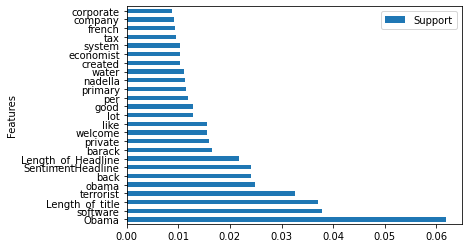

In [176]:
gb_features.iloc[0:25].plot(kind='barh');

- Gradient boosting is performing very well compared to any of the above models as this boosting technique is giving good predictions and learning the data well. 
- R2 score and adjusted r2 score are positive and very much better than any other models which gave negative results.
- The error or bias is also very much less than other models which can be known by rmse and mape scores
- Some of the important features present in the data according to this boosting algorithm are Obama, Length of title, back,software,come,company,good,12th month,order,barack,Length of Headline, giant, former_in_title,tax in title,..etc. This can be seen even in the above plot.

In [177]:
# Gradient boosting for google popularity predictions
go_gb_model=GradientBoostingRegressor(n_estimators=1000,learning_rate=0.08,random_state=25,criterion='mse',\
                                       max_features='sqrt',loss='ls')
go_gb_model.fit(googlex1_train,googley1_train)
go_gb_pred=go_gb_model.predict(googlex1_test)
ic(go_gb_pred);

ic| go_gb_pred: array([ 3.04077396, -1.45775729,  3.36466689, ...,  7.12758375,
                        2.63325436,  1.8738996 ])


In [178]:
ic(rmse(googley1_test,go_gb_pred))
ic(mape(googley1_test,go_gb_pred))
ic(r2_score(googley1_test,go_gb_pred));

ic| rmse(googley1_test,go_gb_pred): 20.469447606980907
ic| mape(googley1_test,go_gb_pred): inf
ic| r2_score(googley1_test,go_gb_pred): 0.005005910204791797


In [155]:
ic(adj_r_sq(googlex1_test,googley1_test,0.005005910204791797));

ic| adj_r_sq(googlex1_test,googley1_test,0.005005910204791797): -0.03200610816351568


In [160]:
# Gradient boosting for linkedin predictions
ln_gb_model=GradientBoostingRegressor(loss='ls',criterion='friedman_mse',learning_rate=0.0001,random_state=25,\
                                      max_features='log2',n_estimators=1000)
ln_gb_model.fit(linkedx1_train,linkedy1_train)
ln_gb_pred=ln_gb_model.predict(linkedx1_test)
ic(ln_gb_pred);

ic| ln_gb_pred: array([16.461165  , 17.03332338, 16.65232082, ..., 16.60933564,
                       16.5970209 , 16.55569737])


In [161]:
ic(rmse(linkedy1_test,ln_gb_pred))
ic(mape(linkedy1_test,ln_gb_pred))
ic(r2_score(linkedy1_test,ln_gb_pred));

ic| rmse(linkedy1_test,ln_gb_pred): 132.47502410000595
ic| mape(linkedy1_test,ln_gb_pred): inf
ic| r2_score(linkedy1_test,ln_gb_pred): 0.0007064274919503788


In [174]:
ic(adj_r_sq(linkedx1_test,linkedy1_test,0.0007064274919503788));

ic| adj_r_sq(linkedx1_test,linkedy1_test,0.0007064274919503788): -0.03262434429981642


- For Linkedin predictions using 0.05 as learning rate gives negative r2 score(-0.0617) hence again when changed it to default 0.1(-0.2074). As it is too bad changed to 0.01 as the learning rate then the model gives r2 score as -0.0245.
- After changing the learning rate to 0.001 the r2 score turns positive which gives 0.0076 and with adj_r2 scores as 0.0048. 
- When 0.0005 is taken I got 0.007380 as r2 score and 0.00456 as adjusted r2 score, when 0.0001 is used as learning rate I got r2 score of 0.00233 and adj r2 score as -0.000506.
- So from all these I found r2 score and adjusted r2 score is good when learning rate 0.001 is used in linkedin popularity predictions in gradient boosting regressor.

#### 4. Catboost regressor
- CatBoost has many useful features in built so it doen't require much processing as it requires in other models
- CatBoost can recognize and process the categorical features without them being encoded.

In [110]:
from catboost import Pool

In [111]:
type(list(cat_df.columns))

list

In [112]:
cat_df.shape

(92945, 1226)

In [113]:
len(new_tnh_df.columns)

1213

In [162]:
cat_fbtrain=Pool(cat_fbx1_train,label=cat_fby1_train,cat_features=cat_feat,feature_names=cat_model_feat)
cat_fbtest=Pool(cat_fbx1_test,label=cat_fby1_test,cat_features=cat_feat,feature_names=cat_model_feat)

In [128]:
# Catboost for fb predictions
fb_cat_model=CatBoostRegressor(iterations=130,learning_rate=0.09)
fb_cat_model.fit(cat_fbtrain,eval_set=cat_fbtest)

0:	learn: 617.9902952	test: 618.2362960	best: 618.2362960 (0)	total: 355ms	remaining: 45.7s
1:	learn: 614.5493880	test: 615.8483082	best: 615.8483082 (1)	total: 501ms	remaining: 32.1s
2:	learn: 611.3041447	test: 613.9670906	best: 613.9670906 (2)	total: 661ms	remaining: 28s
3:	learn: 608.3904500	test: 612.9337765	best: 612.9337765 (3)	total: 835ms	remaining: 26.3s
4:	learn: 606.0591099	test: 610.8127383	best: 610.8127383 (4)	total: 1s	remaining: 25.1s
5:	learn: 603.5232037	test: 609.2180636	best: 609.2180636 (5)	total: 1.17s	remaining: 24.1s
6:	learn: 601.0911267	test: 608.0759705	best: 608.0759705 (6)	total: 1.33s	remaining: 23.5s
7:	learn: 598.2469969	test: 605.6291366	best: 605.6291366 (7)	total: 1.49s	remaining: 22.8s
8:	learn: 595.2713578	test: 603.1183391	best: 603.1183391 (8)	total: 1.66s	remaining: 22.4s
9:	learn: 592.9603194	test: 601.2944476	best: 601.2944476 (9)	total: 1.82s	remaining: 21.9s
10:	learn: 590.9640582	test: 600.1951672	best: 600.1951672 (10)	total: 1.99s	remainin

88:	learn: 548.5951823	test: 584.9562918	best: 584.9290550 (87)	total: 23.2s	remaining: 10.7s
89:	learn: 548.4176400	test: 584.9561060	best: 584.9290550 (87)	total: 23.5s	remaining: 10.5s
90:	learn: 548.0834373	test: 584.9990617	best: 584.9290550 (87)	total: 23.8s	remaining: 10.2s
91:	learn: 547.6665498	test: 584.9770931	best: 584.9290550 (87)	total: 24.1s	remaining: 9.95s
92:	learn: 547.3380353	test: 585.0697136	best: 584.9290550 (87)	total: 24.4s	remaining: 9.7s
93:	learn: 547.1842275	test: 585.0751036	best: 584.9290550 (87)	total: 24.7s	remaining: 9.45s
94:	learn: 547.1182555	test: 585.0750930	best: 584.9290550 (87)	total: 24.8s	remaining: 9.15s
95:	learn: 546.7910628	test: 585.2099858	best: 584.9290550 (87)	total: 25.1s	remaining: 8.9s
96:	learn: 546.3885234	test: 585.2083209	best: 584.9290550 (87)	total: 25.4s	remaining: 8.64s
97:	learn: 546.3008000	test: 585.2074338	best: 584.9290550 (87)	total: 25.7s	remaining: 8.38s
98:	learn: 546.1804296	test: 585.2230348	best: 584.9290550 (87

In [129]:
fb_cat_pred=fb_cat_model.predict(cat_fbx1_test)
ic(fb_cat_pred);

ic| fb_cat_pred: array([ 20.24932725,  -5.95613678, 161.44024749, ..., 467.23653768,
                         13.29273011,   1.14174088])


In [131]:
ic(rmse(cat_fby1_test,fb_cat_pred))
ic(mape(cat_fby1_test,fb_cat_pred))
ic(r2_score(cat_fby1_test,fb_cat_pred));

ic| rmse(cat_fby1_test,fb_cat_pred): 584.5640356122829
ic| mape(cat_fby1_test,fb_cat_pred): inf
ic| r2_score(cat_fby1_test,fb_cat_pred): 0.11432021280524574


In [135]:
ic(adj_r_sq(cat_fbx1_test,cat_fby1_test,0.11432021280524574));

ic| adj_r_sq(cat_fbx1_test,cat_fby1_test,0.11432021280524574): 0.06527594601244002


In [136]:
cat_gotrain=Pool(cat_gox1_train,label=cat_goy1_train,cat_features=cat_feat,feature_names=cat_model_feat)
cat_gotest=Pool(cat_gox1_test,label=cat_goy1_test,cat_features=cat_feat,feature_names=cat_model_feat)

In [138]:
# Catboost for google predictions
go_cat_model=CatBoostRegressor(iterations=1000,learning_rate=0.05,early_stopping_rounds=15)
go_cat_model.fit(cat_gotrain,eval_set=cat_gotest)

0:	learn: 17.5370621	test: 20.4815435	best: 20.4815435 (0)	total: 215ms	remaining: 3m 35s
1:	learn: 17.4839482	test: 20.4465077	best: 20.4465077 (1)	total: 387ms	remaining: 3m 13s
2:	learn: 17.4274035	test: 20.4064771	best: 20.4064771 (2)	total: 572ms	remaining: 3m 10s
3:	learn: 17.3771910	test: 20.3700426	best: 20.3700426 (3)	total: 754ms	remaining: 3m 7s
4:	learn: 17.3316385	test: 20.3389564	best: 20.3389564 (4)	total: 946ms	remaining: 3m 8s
5:	learn: 17.2919117	test: 20.3131688	best: 20.3131688 (5)	total: 1.12s	remaining: 3m 6s
6:	learn: 17.2502538	test: 20.2889546	best: 20.2889546 (6)	total: 1.31s	remaining: 3m 5s
7:	learn: 17.2132831	test: 20.2659205	best: 20.2659205 (7)	total: 1.5s	remaining: 3m 5s
8:	learn: 17.1763336	test: 20.2424485	best: 20.2424485 (8)	total: 1.73s	remaining: 3m 10s
9:	learn: 17.1478060	test: 20.2228450	best: 20.2228450 (9)	total: 1.9s	remaining: 3m 8s
10:	learn: 17.1133339	test: 20.2022915	best: 20.2022915 (10)	total: 2.11s	remaining: 3m 9s
11:	learn: 17.084

90:	learn: 16.4619176	test: 19.9752292	best: 19.9752292 (90)	total: 18.2s	remaining: 3m 1s
91:	learn: 16.4521833	test: 19.9736232	best: 19.9736232 (91)	total: 18.4s	remaining: 3m 1s
92:	learn: 16.4465183	test: 19.9727002	best: 19.9727002 (92)	total: 18.6s	remaining: 3m
93:	learn: 16.4400062	test: 19.9727348	best: 19.9727002 (92)	total: 18.7s	remaining: 3m
94:	learn: 16.4339635	test: 19.9713946	best: 19.9713946 (94)	total: 18.9s	remaining: 3m
95:	learn: 16.4319164	test: 19.9715128	best: 19.9713946 (94)	total: 19.1s	remaining: 3m
96:	learn: 16.4304725	test: 19.9714951	best: 19.9713946 (94)	total: 19.3s	remaining: 2m 59s
97:	learn: 16.4257347	test: 19.9699312	best: 19.9699312 (97)	total: 19.5s	remaining: 2m 59s
98:	learn: 16.4199162	test: 19.9690318	best: 19.9690318 (98)	total: 19.7s	remaining: 2m 59s
99:	learn: 16.4133953	test: 19.9694286	best: 19.9690318 (98)	total: 19.9s	remaining: 2m 59s
100:	learn: 16.4110228	test: 19.9693624	best: 19.9690318 (98)	total: 20.1s	remaining: 2m 58s
101:	

In [142]:
go_cat_pred=go_cat_model.predict(cat_gox1_test)
ic(go_cat_pred);

ic| go_cat_pred: array([2.92923377, 2.29917177, 2.69731335, ..., 1.77747069, 2.86271515,
                        2.14316957])


In [143]:
ic(rmse(cat_goy1_test,go_cat_pred))
ic(mape(cat_goy1_test,go_cat_pred))
ic(r2_score(cat_goy1_test,go_cat_pred));

ic| rmse(cat_goy1_test,go_cat_pred): 19.957161049863124
ic| mape(cat_goy1_test,go_cat_pred): inf
ic| r2_score(cat_goy1_test,go_cat_pred): 0.05418591032597886


In [144]:
ic(adj_r_sq(cat_gox1_test,cat_goy1_test,0.05418591032597886));

ic| adj_r_sq(cat_gox1_test,cat_goy1_test,0.05418591032597886): 0.0018117236040601226


In [114]:
cat_lntrain=Pool(cat_lnx1_train,label=cat_lny1_train,cat_features=cat_feat,feature_names=cat_model_feat)
cat_lntest=Pool(cat_lnx1_test,label=cat_lny1_test,cat_features=cat_feat,feature_names=cat_model_feat)

In [209]:
# Catboost for linkedin predictions
ln_cat_model=CatBoostRegressor(iterations=50,learning_rate=0.5980,depth=4,loss_function='RMSE',) 
ln_cat_model.fit(cat_lntrain,eval_set=cat_lntest)

0:	learn: 138.7502031	test: 133.5611427	best: 133.5611427 (0)	total: 73.6ms	remaining: 3.61s
1:	learn: 116.4666674	test: 133.0815776	best: 133.0815776 (1)	total: 144ms	remaining: 3.45s
2:	learn: 103.4826416	test: 132.8429669	best: 132.8429669 (2)	total: 210ms	remaining: 3.29s
3:	learn: 97.7032709	test: 130.9786943	best: 130.9786943 (3)	total: 276ms	remaining: 3.17s
4:	learn: 95.0027712	test: 130.1250435	best: 130.1250435 (4)	total: 354ms	remaining: 3.18s
5:	learn: 92.9321013	test: 130.0507558	best: 130.0507558 (5)	total: 421ms	remaining: 3.08s
6:	learn: 92.8307978	test: 130.0505955	best: 130.0505955 (6)	total: 498ms	remaining: 3.06s
7:	learn: 91.5569685	test: 129.8794512	best: 129.8794512 (7)	total: 580ms	remaining: 3.04s
8:	learn: 90.1606586	test: 129.8725701	best: 129.8725701 (8)	total: 649ms	remaining: 2.96s
9:	learn: 89.8352352	test: 129.8714310	best: 129.8714310 (9)	total: 718ms	remaining: 2.87s
10:	learn: 89.5995418	test: 129.8711994	best: 129.8711994 (10)	total: 787ms	remaining:

In [210]:
ln_cat_pred=ln_cat_model.predict(cat_lnx1_test)
ic(ln_cat_pred);

ic| ln_cat_pred: array([-0.06634825,  4.26470643,  6.32182799, ...,  2.03485888,
                        39.24445396,  0.67464267])


In [211]:
ic(rmse(cat_lny1_test,ln_cat_pred))
ic(mape(cat_lny1_test,ln_cat_pred))
ic(r2_score(cat_lny1_test,ln_cat_pred));

ic| rmse(cat_lny1_test,ln_cat_pred): 128.1905948132104
ic| mape(cat_lny1_test,ln_cat_pred): inf
ic| r2_score(cat_lny1_test,ln_cat_pred): 0.0642983290454705


In [212]:
ic(adj_r_sq(cat_lnx1_test,cat_lny1_test,0.0642983290454705));

ic| adj_r_sq(cat_lnx1_test,cat_lny1_test,0.0642983290454705): 0.021373980074075538


#### 5. XGB regressor

In [162]:
# XGboost for fb predictions
fb_xgb_model=XGBRegressor(n_estimators=30,learning_rate=0.07,)
fb_xgb_model.fit(fbx1_train,fby1_train)
fb_xgb_pred=fb_xgb_model.predict(fbx1_test)
ic(fb_xgb_pred);

ic| fb_xgb_pred: array([ 35.709583,  27.445932, 264.4146  , ..., 228.12971 ,  27.445932,
                         27.445932], dtype=float32)


In [163]:
ic(rmse(fby1_test,fb_xgb_pred))
ic(mape(fby1_test,fb_xgb_pred))
ic(r2_score(fby1_test,fb_xgb_pred));

ic| rmse(fby1_test,fb_xgb_pred): 602.1041740376984
ic| mape(fby1_test,fb_xgb_pred): inf
ic| r2_score(fby1_test,fb_xgb_pred): 0.06037227194858352


In [175]:
ic(adj_r_sq(fbx1_test,fby1_test,0.06037227194858352));

ic| adj_r_sq(fbx1_test,fby1_test,0.06037227194858352): 0.02903161467377069


In [164]:
# XGboost for google predictions
go_xgb_model=XGBRegressor(n_estimators=50,learning_rate=0.05)
go_xgb_model.fit(googlex1_train,googley1_train)
go_xgb_pred=go_xgb_model.predict(googlex1_test)
ic(go_xgb_pred);

ic| go_xgb_pred: array([2.0534904, 1.1313574, 3.1042423, ..., 6.1888866, 5.105164 ,
                        1.9099828], dtype=float32)


In [165]:
ic(rmse(googley1_test,go_xgb_pred))
ic(mape(googley1_test,go_xgb_pred))
ic(r2_score(googley1_test,go_xgb_pred));

ic| rmse(googley1_test,go_xgb_pred): 20.43823763856033
ic| mape(googley1_test,go_xgb_pred): inf
ic| r2_score(googley1_test,go_xgb_pred): 0.008037751683837802


In [176]:
ic(adj_r_sq(fbx1_test,fby1_test,0.008037751683837802));

ic| adj_r_sq(fbx1_test,fby1_test,0.008037751683837802): -0.025048488670627922


In [166]:
# XGBboost for linkedin predictions
ln_xgb_model=XGBRegressor(n_estimators=500,learning_rate=0.0005)
ln_xgb_model.fit(linkedx1_train,linkedy1_train)
ln_xgb_pred=ln_xgb_model.predict(linkedx1_test)
ic(ln_xgb_pred);

ic| ln_xgb_pred: array([3.3559546, 3.3559546, 3.4470131, ..., 3.4470131, 3.4470131,
                        3.3559546], dtype=float32)


In [167]:
ic(rmse(linkedy1_test,ln_xgb_pred))
ic(mape(linkedy1_test,ln_xgb_pred))
ic(r2_score(linkedy1_test,ln_xgb_pred));

ic| rmse(linkedy1_test,ln_xgb_pred): 132.8796636546516
ic| mape(linkedy1_test,ln_xgb_pred): inf
ic| r2_score(linkedy1_test,ln_xgb_pred): -0.005407498507879582


In [177]:
ic(adj_r_sq(fbx1_test,fby1_test,-0.005407498507879582));

ic| adj_r_sq(fbx1_test,fby1_test,-0.005407498507879582): -0.038942196230782544


#### 6. KNN Regressor

In [168]:
fb_knn_model=KNeighborsRegressor(n_neighbors=230,)
fb_knn_model.fit(fbx1_train,fby1_train)
fb_knn_pred=fb_knn_model.predict(fbx1_test)
ic(fb_knn_pred);

ic| fb_knn_pred: array([ 45.00869565,  13.54782609, 222.6826087 , ..., 377.13913043,
                         16.33043478,  42.9826087 ])


In [169]:
ic(rmse(fby1_test,fb_knn_pred))
ic(mape(fby1_test,fb_knn_pred))
ic(r2_score(fby1_test,fb_knn_pred));

ic| rmse(fby1_test,fb_knn_pred): 605.7384345802175
ic| mape(fby1_test,fb_knn_pred): inf
ic| r2_score(fby1_test,fb_knn_pred): 0.0489949786710242


In [178]:
ic(adj_r_sq(fbx1_test,fby1_test,0.0489949786710242));

ic| adj_r_sq(fbx1_test,fby1_test,0.0489949786710242): 0.01727483935382157


- KNN is performing well compared to other models then still it is not having a satisfactory score for choosing it for the predictions as the r2 score and adjusted r2 score are still having low scores.

In [170]:
# KNN Regressor for google predictions
go_knn_model=KNeighborsRegressor(n_neighbors=140,)
go_knn_model.fit(googlex1_train,googley1_train)
go_knn_pred=go_knn_model.predict(googlex1_test)
ic(go_knn_pred);

ic| go_knn_pred: array([1.90714286, 0.67142857, 2.59285714, ..., 4.95714286, 4.08571429,
                        1.17142857])


In [171]:
ic(rmse(googley1_test,go_knn_pred))
ic(mape(googley1_test,go_knn_pred))
ic(r2_score(googley1_test,go_knn_pred));

ic| rmse(googley1_test,go_knn_pred): 20.283876748721717
ic| mape(googley1_test,go_knn_pred): inf
ic| r2_score(googley1_test,go_knn_pred): 0.022964865640639154


In [179]:
ic(adj_r_sq(googlex1_test,googley1_test,0.022964865640639154));

ic| adj_r_sq(googlex1_test,googley1_test,0.022964865640639154): -0.009623490766114129


In [172]:
# KNN regressor for linkedin predictions
ln_knn_model=KNeighborsRegressor(n_neighbors=320,)
ln_knn_model.fit(linkedx1_train,linkedy1_train)
ln_knn_pred=ln_knn_model.predict(linkedx1_test)
ic(ln_knn_pred);

ic| ln_knn_pred: array([ 7.33125, 11.39375, 15.49375, ..., 21.7375 , 16.95625, 13.55   ])


In [173]:
ic(rmse(linkedy1_test,ln_knn_pred))
ic(mape(linkedy1_test,ln_knn_pred))
ic(r2_score(linkedy1_test,ln_knn_pred));

ic| rmse(linkedy1_test,ln_knn_pred): 129.64830004657452
ic| mape(linkedy1_test,ln_knn_pred): inf
ic| r2_score(linkedy1_test,ln_knn_pred): 0.042896877823344504


In [180]:
ic(adj_r_sq(linkedx1_test,linkedy1_test,0.042896877823344504));

ic| adj_r_sq(linkedx1_test,linkedy1_test,0.042896877823344504): 0.010973340412419486


### Results after modelling

In [204]:
eval_df1=pd.DataFrame(columns=['Models','r2(fb)','r2(g+)','r2(ln)','adj_r2(fb)','adj_r2(g+)','adj_r2(ln)','rmse(fb)','rmse(g+)',\
                              'rmse(ln)'],)
eval_df1['Models']=['Linear regression','Decision tree','Gradient boosting','Catboost','XG Boost','KNN Regressor']
eval_df1

,Models,r2(fb),r2(g+),r2(ln),adj_r2(fb),adj_r2(g+),adj_r2(ln),rmse(fb),rmse(g+),rmse(ln)
0,Linear regression,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Decision tree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Gradient boosting,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Catboost,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,XG Boost,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,KNN Regressor,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [205]:
eval_df1['r2(fb)']=[r2_score(fby1_test,fb_lr_pred),r2_score(fby1_test,fb_dt_pred),r2_score(fby1_test,fb_gb_pred),\
                  r2_score(fby1_test,fb_cat_pred),r2_score(fby1_test,fb_xgb_pred),r2_score(fby1_test,fb_knn_pred)]

eval_df1['r2(g+)']=[r2_score(googley1_test,go_lr_pred),r2_score(googley1_test,go_dt_pred),r2_score(googley1_test,go_gb_pred),\
                    r2_score(googley1_test,go_cat_pred),r2_score(googley1_test,go_xgb_pred),r2_score(googley1_test,go_knn_pred)]

eval_df1['r2(ln)']=[r2_score(linkedy1_test,ln_lr_pred),r2_score(linkedy1_test,ln_dt_pred),r2_score(linkedy1_test,ln_gb_pred),\
                    r2_score(linkedy1_test,ln_cat_pred),r2_score(linkedy1_test,ln_xgb_pred),r2_score(linkedy1_test,ln_knn_pred)]

eval_df1['adj_r2(fb)']=[adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_lr_pred)),adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_dt_pred)),\
                      adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_gb_pred)),adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_cat_pred)),\
                       adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_xgb_pred)),adj_r_sq(fbx1_test,fby1_test,r2_score(fby1_test,fb_knn_pred))]
eval_df1['adj_r2(g+)']= [adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_lr_pred)),adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_dt_pred)),\
                      adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_gb_pred)),adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_cat_pred)),\
                        adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_xgb_pred)),adj_r_sq(googlex1_test,googley1_test,r2_score(googley1_test,go_knn_pred))]

eval_df1['adj_r2(ln)']=[adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_lr_pred)),adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_dt_pred)),\
                      adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_gb_pred)),adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_cat_pred)),\
                       adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_xgb_pred)),adj_r_sq(linkedx1_test,linkedy1_test,r2_score(linkedy1_test,ln_knn_pred))]

eval_df1['rmse(fb)'] = [rmse(fby1_test,fb_lr_pred),rmse(fby1_test,fb_dt_pred),\
                      rmse(fby1_test,fb_gb_pred),rmse(fby1_test,fb_cat_pred),\
                       rmse(fby1_test,fb_xgb_pred),rmse(fby1_test,fb_knn_pred)]

eval_df1['rmse(g+)'] = [rmse(googley1_test,go_lr_pred),rmse(googley1_test,go_dt_pred),\
                      rmse(googley1_test,go_gb_pred),rmse(googley1_test,go_cat_pred),\
                       rmse(googley1_test,go_xgb_pred),rmse(googley1_test,go_knn_pred)]

eval_df1['rmse(ln)'] = [rmse(linkedy1_test,ln_lr_pred),rmse(linkedy1_test,ln_dt_pred),\
                      rmse(linkedy1_test,ln_gb_pred),rmse(linkedy1_test,ln_cat_pred),\
                       rmse(linkedy1_test,ln_xgb_pred),rmse(linkedy1_test,ln_knn_pred)]

In [206]:
eval_df1

,Models,r2(fb),r2(g+),r2(ln),adj_r2(fb),adj_r2(g+),adj_r2(ln),rmse(fb),rmse(g+),rmse(ln)
0,Linear regression,-1.833322e+17,0.028735,0.052089,-1.901518e+17,-0.007394,0.016828,2.659580e+11,20.223889,129.024229
1,Decision tree,-7.269442e-01,-0.651056,-0.447608,-7.911834e-01,-0.712473,-0.501456,8.162682e+02,26.367976,159.445723
2,Gradient boosting,7.437725e-03,-0.030462,0.014147,-2.948383e-02,-0.068793,-0.022525,6.188318e+02,20.831084,131.581109
3,Catboost,7.995492e-02,0.023191,0.034918,4.573087e-02,-0.013144,-0.000981,5.957970e+02,20.281528,130.187579
4,XG Boost,1.457895e-02,0.013686,-0.003587,-2.207697e-02,-0.023004,-0.040919,6.166016e+02,20.379971,132.759327
5,KNN Regressor,4.845445e-02,0.026010,0.030624,1.305864e-02,-0.010221,-0.005435,6.059106e+02,20.252244,130.476865


### Hyperparameter tuning

In [180]:
# Gradient boosting parameters for fb predictions
grid_param={'loss':['ls','huber','quantile'],'learning_rate':[0.3,0.05],'n_estimators':[50,100],\
            'criterion':['friedman_mse','mse','lad'],'max_features':['auto','sqrt','log2']}

In [181]:
fb_gb_grid=GridSearchCV(estimator=fb_gb_model,param_grid=grid_param,cv=3,n_jobs=-1,verbose=10)

In [182]:
fb_gb_grid.fit(fbx1_train,fby1_train)

Fitting 3 folds for each of 108 candidates, totalling 324 fits


GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'learning_rate': [0.3, 0.05],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)

 - fb_gb_grid.fit(fbx1_train,fby1_train)
 - Output: GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'learning_rate': [0.3, 0.05],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)

In [183]:
fb_gb_grid.best_params_

{'criterion': 'friedman_mse',
 'learning_rate': 0.3,
 'loss': 'ls',
 'max_features': 'sqrt',
 'n_estimators': 50}

- Best params: {'criterion': 'friedman_mse','learning_rate': 0.3,'loss': 'ls','max_features': 'sqrt','n_estimators': 50}

In [184]:
fb_gb_grid.best_score_

0.05953076272331037

In [185]:
fb_gb_grid.best_estimator_

GradientBoostingRegressor(learning_rate=0.3, max_features='sqrt',
                          n_estimators=50, random_state=25)

- Best estimator: GradientBoostingRegressor(learning_rate=0.3, max_features='sqrt',n_estimators=50, random_state=25)

In [186]:
fb_gb_grid.score

<bound method BaseSearchCV.score of GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'learning_rate': [0.3, 0.05],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)>

- fb_gb_grid.score
- Output: <bound method BaseSearchCV.score of GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'learning_rate': [0.3, 0.05],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)>

In [259]:
#Gradient boosting tuning for google+ predictions
grid_param1={'loss':['ls','huber','quantile'],'max_depth':[50,100],'n_estimators':[50,100],\
            'criterion':['friedman_mse','mse','lad'],'max_features':['auto','sqrt','log2']}

In [260]:
go_gb_grid1=GridSearchCV(estimator=go_gb_model,param_grid=grid_param1,cv=3,n_jobs=-1,verbose=10)

In [261]:
go_gb_grid1.fit(googlex1_train,googley1_train)

Fitting 3 folds for each of 108 candidates, totalling 324 fits


GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_depth': [50, 100],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)

In [262]:
go_gb_grid1.best_params_

{'criterion': 'mse',
 'loss': 'huber',
 'max_depth': 100,
 'max_features': 'sqrt',
 'n_estimators': 50}

In [274]:
go_gb_grid1.best_estimator_

GradientBoostingRegressor(criterion='mse', learning_rate=0.05, loss='huber',
                          max_depth=100, max_features='sqrt', n_estimators=50,
                          random_state=25)

In [357]:
go_gb_grid1.estimator

GradientBoostingRegressor(learning_rate=0.05, n_estimators=1000,
                          random_state=25)

In [359]:
go_gb_grid1.score

<bound method BaseSearchCV.score of GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.05,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse', 'lad'],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_depth': [50, 100],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [50, 100]},
             verbose=10)>

In [ ]:
#Gradient boosting tuning for linkedin predictions
grid_param2={'loss':['ls','huber','quantile'],'learning_rate':[0.001,0.01,0.0005],\
            'criterion':['friedman_mse','mse'],'max_features':['auto','sqrt','log2']}

In [ ]:
ln_gb_grid2=GridSearchCV(estimator=ln_gb_model,param_grid=grid_param2,cv=3,n_jobs=-1,verbose=10)

In [ ]:
ln_gb_grid2.fit(linkedx1_train,linkedy1_train)

In [277]:
ln_gb_grid2.best_params_

{'criterion': 'friedman_mse',
 'learning_rate': 0.01,
 'loss': 'ls',
 'max_features': 'log2'}

In [278]:
ln_gb_grid2.best_estimator_

GradientBoostingRegressor(learning_rate=0.01, max_features='log2',
                          n_estimators=1000, random_state=25)

In [279]:
ln_gb_grid2.best_index_

11

In [280]:
ln_gb_grid2.cv_results_

{'mean_fit_time': array([368.47753406,  49.28036118,  40.25570567, 409.60664574,
         94.65577459,  87.77341302, 385.91541982,  80.62831481,
         67.52432998, 355.72755329,  45.91251214,  37.86364047,
        413.65080992,  93.81344247,  87.06792434, 404.58914574,
         79.05644997,  67.76287381, 364.31344   ,  48.99322899,
         39.52799463, 399.12249502,  92.56786577,  84.05637924,
        385.83870268,  75.23610973,  65.78834073, 363.48930295,
         49.42670449,  38.67864283, 402.12394659,  94.20586642,
         85.79476651, 392.2082154 ,  75.91806483,  66.77673093,
        401.69623613,  46.59296926,  39.72731702, 522.18785111,
        109.50359853, 114.39421805, 473.14121453, 107.37201047,
         74.43683044, 372.1629204 ,  50.6153361 ,  39.46059275,
        396.95664469,  93.39195792,  80.25415913, 308.26173099,
         74.51459638,  63.06983566]),
 'std_fit_time': array([ 3.00120196,  0.95150154,  0.73305448,  1.58849397,  0.5781918 ,
         1.44261033,  2.

In [282]:
ln_gb_grid2.score

<bound method BaseSearchCV.score of GridSearchCV(cv=3,
             estimator=GradientBoostingRegressor(learning_rate=0.001,
                                                 n_estimators=1000,
                                                 random_state=25),
             n_jobs=-1,
             param_grid={'criterion': ['friedman_mse', 'mse'],
                         'learning_rate': [0.001, 0.01, 0.0005],
                         'loss': ['ls', 'huber', 'quantile'],
                         'max_features': ['auto', 'sqrt', 'log2']},
             verbose=10)>

### Model building after hypertuning

In [562]:
fb_gb_model1=GradientBoostingRegressor(n_estimators=50,learning_rate=0.3,random_state=25,criterion='friedman_mse',\
                                       max_features='sqrt',loss='ls')
fb_gb_model1.fit(fbx1_train,fby1_train)
fb_gb_pred1=fb_gb_model1.predict(fbx1_test)
ic(fb_gb_pred1);

ic| fb_gb_pred1: array([ 79.66380041,  23.73696898, 167.8071186 , ..., 318.638449  ,
                          3.31060706, -38.81479901])


In [563]:
ic(rmse(fby1_test,fb_gb_pred1))
ic(mape(fby1_test,fb_gb_pred1))
ic(r2_score(fby1_test,fb_gb_pred1));

ic| rmse(fby1_test,fb_gb_pred1): 615.8521086627658
ic| mape(fby1_test,fb_gb_pred1): inf
ic| r2_score(fby1_test,fb_gb_pred1): 0.016973073687589824


In [564]:
ic(adj_r_sq(fbx1_train,fby1_train,0.016973073687589824));

ic| adj_r_sq(fbx1_train,fby1_train,0.016973073687589824): 0.0031837308933072572


In [565]:
gb_features1=pd.DataFrame()
gb_features1['Features']=fbx1.columns
gb_features1['Support']=fb_gb_model1.feature_importances_
gb_features1.sort_values('Support',ascending=False,inplace=True)
gb_features1.set_index('Features',inplace=True)

<AxesSubplot:ylabel='Features'>

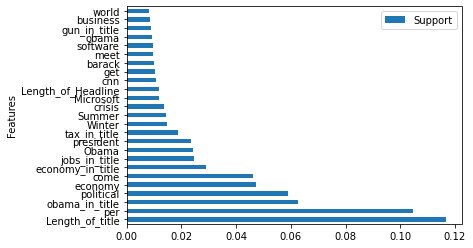

In [566]:
gb_features1.iloc[0:25].plot(kind='barh')

- This cannot be considered as it is less than the score obtained with other hyperparameters in model building stage

In [567]:
# GB model for google predictions after tuning
go_gb_model1=GradientBoostingRegressor(n_estimators=1000,learning_rate=0.08,random_state=25,criterion='mse',\
                                       max_features='sqrt',loss='ls')
go_gb_model1.fit(googlex1_train,googley1_train)
go_gb_pred1=go_gb_model1.predict(googlex1_test)
ic(go_gb_pred1);

ic| go_gb_pred1: array([ 2.36538227, -1.9254928 ,  6.52414739, ...,  6.90171959,
                         5.51021244,  0.16253487])


In [571]:
ic(rmse(googley1_test,go_gb_pred1))
ic(mape(googley1_test,go_gb_pred1))
ic(r2_score(googley1_test,go_gb_pred1));

ic| rmse(googley1_test,go_gb_pred1): 20.503500759948444
ic| mape(googley1_test,go_gb_pred1): inf
ic| r2_score(googley1_test,go_gb_pred1): 0.001692594637144773


In [570]:
ic(adj_r_sq(googlex1_test,googley1_test,0.001692594637144773));

ic| adj_r_sq(googlex1_test,googley1_test,0.001692594637144773): -0.03160528420607389


- This score better than obtained while model building. So this can be considered for comparison with other models.

In [356]:
# 0.05 gives -0.0071, 0.01 gives -0.019,0.09 gives -0.0045,0.5 gives 0.00156,0.3 gives 0.00025,0.589 gives 0.00169,0.899 gives 0.00161,0.789 gives 0.0021,0.89 gives 0.0034.
# When estimators has been increased r2 score was improved to 0.00463,0.05 gives 0.00070,0.10 gives 0.0028
# When loss function is changed there more improvement with r2 score of 0.0446 when 0.05 is used,0.0446 with 0.0889,0.0447 \
#when 0.08 is used.

In [575]:
# GB for linkedin predictions
#ln_gb_model1=GradientBoostingRegressor(loss='ls',criterion='friedman_mse',learning_rate=0.0001,random_state=25,\
           #                            max_features='log2',n_estimators=1000,max_depth=150)
#ln_gb_model1.fit(linkedx1_train,linkedy1_train)
#ln_gb_pred1=ln_gb_model1.predict(linkedx1_test)
#ic(ln_gb_pred1)

In [577]:
# GB for linkedin predictions
#ln_gb_model2=GradientBoostingRegressor(loss='ls',criterion='friedman_mse',learning_rate=0.00078,random_state=25,\
 #                                      max_features='log2',n_estimators=1000,max_depth=200)
#ln_gb_model2.fit(linkedx1_train,linkedy1_train)

In [ ]:
#ln_gb_pred2=ln_gb_model2.predict(linkedx1_test)
#ic(ln_gb_pred2);

In [156]:
#ic(adj_r_sq(linkedx1_test,linkedy1_test,));

ic| adj_r_sq(linkedx1_test,linkedy1_test,0.005502664941714586): 0.0026769819655383387


In [ ]:
# When learning rate is 0.001, max_depth is 100 you get 0.0022 and when max depth is 50 it is 0.0011.
# When max depth was increased to 150, lr at 0.0001 the r2 score is 0.004305.
# When max depth is 200, lr is 0.0078 then r2 is 0.00550

### Final results of models after tuning

In [5]:
eval_df2=pd.DataFrame(columns=['Models','r2(fb)','r2(g+)','r2(ln)','adj_r2(fb)','adj_r2(g+)','adj_r2(ln)','rmse(fb)','rmse(g+)',\
                              'rmse(ln)'],)
eval_df2['Models']=['Linear regression','Decision tree','Gradient boosting','Catboost','XG Boost','KNN Regressor']
eval_df2

,Models,r2(fb),r2(g+),r2(ln),adj_r2(fb),adj_r2(g+),adj_r2(ln),rmse(fb),rmse(g+),rmse(ln)
0,Linear regression,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Decision tree,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Gradient boosting,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Catboost,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,XG Boost,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,KNN Regressor,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [213]:
eval_df2['r2(fb)']=[-3.3996013373823443e+17,-0.519842,0.0134801,0.11432021280524574,0.06037,0.048995]

eval_df2['r2(g+)']=[0.024841,-0.596927,0.0050059,0.0541859,0.0080377,0.022965]

eval_df2['r2(ln)']=[0.04974747,-1.75862,0.000706,0.0642983290454705,-0.00541,0.042897]

eval_df2['adj_r2(fb)']=[-3.526060487677414e+17,-0.57638,-0.02322,0.065276,0.0290,0.01727]

eval_df2['adj_r2(g+)']= [-0.0114328,-0.656329656,-0.0320061,0.00181172,-0.02504849,-0.009623]

eval_df2['adj_r2(ln)']=[0.0114328,-1.8612,-0.032624,0.021373980074075538,-0.03894,0.0109733]
    
eval_df2['rmse(fb)'] = [362166037576.12274,765.76052,616.9453,584.5640,602.1042,605.7384]

eval_df2['rmse(g+)'] = [20.264389,25.93214,20.46945,19.95716,20.43824,20.28388]

eval_df2['rmse(ln)'] = [129.1834793,220.1066,132.47502,128.190594813,132.87966,129.64830]

In [214]:
eval_df2

,Models,r2(fb),r2(g+),r2(ln),adj_r2(fb),adj_r2(g+),adj_r2(ln),rmse(fb),rmse(g+),rmse(ln)
0,Linear regression,-3.399601e+17,0.024841,0.049747,-3.526060e+17,-0.011433,0.011433,3.621660e+11,20.264389,129.183479
1,Decision tree,-5.198420e-01,-0.596927,-1.758620,-5.763800e-01,-0.656330,-1.861200,7.657605e+02,25.932140,220.106600
2,Gradient boosting,1.348010e-02,0.005006,0.000706,-2.322000e-02,-0.032006,-0.032624,6.169453e+02,20.469450,132.475020
3,Catboost,1.143202e-01,0.054186,0.064298,6.527600e-02,0.001812,0.021374,5.845640e+02,19.957160,128.190595
4,XG Boost,6.037000e-02,0.008038,-0.005410,2.900000e-02,-0.025048,-0.038940,6.021042e+02,20.438240,132.879660
5,KNN Regressor,4.899500e-02,0.022965,0.042897,1.727000e-02,-0.009623,0.010973,6.057384e+02,20.283880,129.648300


- After hyperparameter tuning and building the models the scores have increased and has shown the improvement in the performance on popular news predictions on different social media platforms.
- CatBoost is the best model for making predictions on this dataset as it was performed very well compared to any other model in all the evaluation metrics used. It has shown good r2_score, adjusted r2_score and low rmse scores.

### Case studies

In [114]:
cat_df.head()

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
0,0.265060,0.283146,0.496953,0.408198,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2002,4,Summer,Firsthalf
1,0.234940,0.305618,0.605854,0.348267,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2008,9,Winter,Secondhalf
2,0.265060,0.305618,0.274684,0.520434,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,Bloomberg,Economy,-1,-1,-1,2012,1,Spring,Secondhalf
3,0.126506,0.393258,0.496953,0.454338,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,RTT News,Economy,-1,-1,-1,2015,3,Spring,Firsthalf
4,0.289157,0.382022,0.496953,0.521207,0.0,0.0,0.0,0.175485,0.0,0.0,...,0.0,The Nation - Thailand&#39;s English news,Economy,-1,-1,-1,2015,3,Spring,Firsthalf


In [130]:
#1. Find the reactions on facebook,g+,ln when Sentiment Title and Headline is >0.70 and from the year 2015
case1=cat_df[(cat_df['SentimentTitle']>0.70)&(cat_df['SentimentHeadline']>0.70)&(cat_df['Published_year']=='2015')]
case1

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
18612,0.355422,0.301124,0.858505,0.70243,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,The Nation,Economy,8,0,0,2015,12,Winter,Secondhalf


- Here the sentiment is scores for Title and Headline greater than 70% and from the year 2015 is on 'Economy' Topic sourced from 'The Nation'.
- This is the only news which is from the last month of the year 2015 and also the last days ie.., from second half of the month Dec.
- The number of likes or reactions generated on this news on Facebook are 8 and on GooglePlus and LinkedIn it is 0

In [133]:
#2.Bloomberg reachtions on Fb,g+,ln with sentiment >0.50 on all the topics
case2=cat_df[(cat_df['SentimentTitle']>0.50)&(cat_df['SentimentHeadline']>0.50)&(cat_df['Source']=='Bloomberg')]
case2

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
572,0.168675,0.137079,0.512513,0.577069,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Microsoft,-1,-1,-1,2015,11,Winter,Firsthalf
855,0.385542,0.350562,0.553539,0.666480,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,110,4,95,2015,11,Winter,Firsthalf
1909,0.210843,0.303371,0.523628,0.550192,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,4,0,0,2015,11,Winter,Firsthalf
2035,0.361446,0.316854,0.538117,0.513355,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Microsoft,-1,-1,-1,2015,11,Winter,Firsthalf
2231,0.337349,0.312360,0.558940,0.508070,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,17,12,49,2015,11,Winter,Firsthalf
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90741,0.313253,0.316854,0.514279,0.520526,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,0,0,2016,6,Rainy,Secondhalf
90817,0.253012,0.301124,0.520054,0.518476,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,0,58,2016,6,Rainy,Secondhalf
91171,0.355422,0.561798,0.513276,0.531531,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Microsoft,-1,-1,-1,2016,7,Rainy,Firsthalf
92030,0.361446,0.325843,0.513288,0.533891,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,Bloomberg,Economy,-1,2,6,2016,7,Rainy,Firsthalf


In [136]:
case2['Topic'].value_counts()

Economy      89
Obama        19
Microsoft     9
Name: Topic, dtype: int64

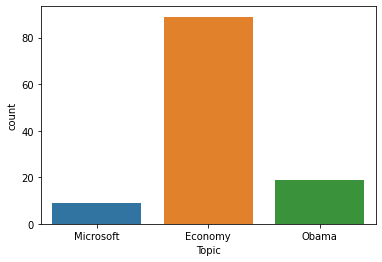

In [152]:
sns.countplot(case2['Topic']);

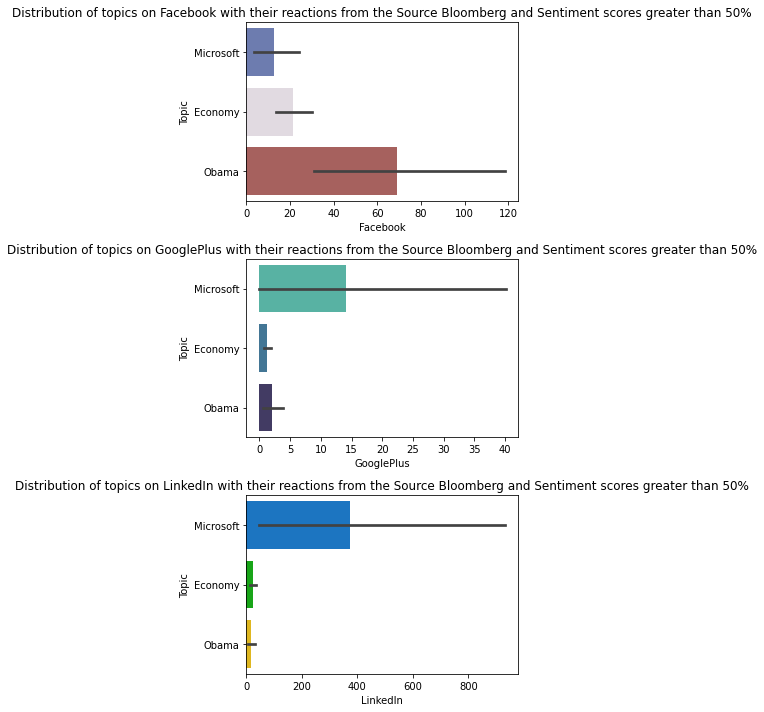

In [172]:
plt.figure(figsize=(5,10))
plt.subplot(3,1,1)
plt.title('Distribution of topics on Facebook with their reactions from the Source Bloomberg and Sentiment scores greater than 50%')
sns.barplot(y='Topic',x='Facebook',data=case2,palette='twilight_shifted');
plt.subplot(3,1,2)
plt.title('Distribution of topics on GooglePlus with their reactions from the Source Bloomberg and Sentiment scores greater than 50%')
sns.barplot(y='Topic',x='GooglePlus',data=case2,palette='mako_r');
plt.subplot(3,1,3)
plt.title('Distribution of topics on LinkedIn with their reactions from the Source Bloomberg and Sentiment scores greater than 50%')
sns.barplot(y='Topic',x='LinkedIn',data=case2,palette='nipy_spectral');
plt.tight_layout()

In [137]:
ic(max(case2['Facebook']));
ic(max(case2['GooglePlus']));
ic(max(case2['LinkedIn']));

ic| max(case2['Facebook']): 437
ic| max(case2['GooglePlus']): 118
ic| max(case2['LinkedIn']): 2572


- It is known from the analysis that from the sample data Bloomberg source news are more than any other.
- So, from Bloomberg news where the Sentiment of Title and Headline are greater than 50% the more news is on Economy topic(89) and other news are less from Blooberg where the sentiment is greater than 50%.
- The reactions generated on Bloomberg where sentiment is greater than 50% are 437 likes on Facebook, 118 likes on GooglePlus and 2572 likes on LinkedIn.
- It can be observed that this Source with Sentiment score greater than 50% has more reactions on LinkedIn than on facebook and googleplus with more than the double reactions of Facebook and GooglePlus. 😯

In [149]:
#3. News reactions from Source USA TODAY from the year 2015
case3=cat_df[(cat_df['Source']=='USA TODAY')&(cat_df['Published_year']=='2015')]#|(cat_df['Published_year']=='2015')]
case3

,Length_of_title,Length_of_Headline,SentimentTitle,SentimentHeadline,abbas,able,access,according,across,act,...,youre,Source,Topic,Facebook,GooglePlus,LinkedIn,Published_year,Published_month,Published_Season,Published_Days_in_month
435,0.361446,0.328090,0.499005,0.439185,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,-1,-1,-1,2015,11,Winter,Firsthalf
608,0.373494,0.296629,0.525794,0.321295,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Microsoft,-1,-1,-1,2015,11,Winter,Firsthalf
1128,0.289157,0.316854,0.404547,0.546227,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Economy,42,4,43,2015,11,Winter,Firsthalf
1167,0.403614,0.334831,0.534677,0.434417,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Economy,12,3,3,2015,11,Winter,Firsthalf
2909,0.355422,0.305618,0.518733,0.411433,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Economy,30,0,15,2015,11,Winter,Secondhalf
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19219,0.265060,0.287640,0.496953,0.611766,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,26,0,0,2015,12,Winter,Secondhalf
19320,0.349398,0.298876,0.545165,0.494254,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,35,0,0,2015,12,Winter,Secondhalf
19570,0.253012,0.294382,0.609919,0.393726,0.0,0.0,0.0,0.175317,0.0,0.0,...,0.0,USA TODAY,Economy,34,3,21,2015,12,Winter,Secondhalf
20106,0.234940,0.301124,0.489560,0.431116,0.0,0.0,0.0,0.000000,0.0,0.0,...,0.0,USA TODAY,Obama,14,0,6,2015,12,Winter,Secondhalf


In [150]:
case3['Topic'].value_counts()

Obama        90
Economy      13
Microsoft    11
Palestine     1
Name: Topic, dtype: int64

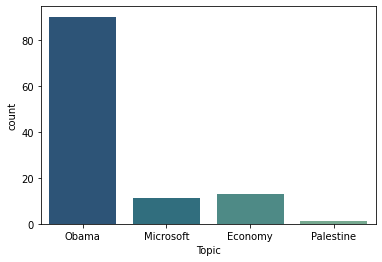

In [171]:
sns.countplot(case3['Topic'],palette='crest_r');

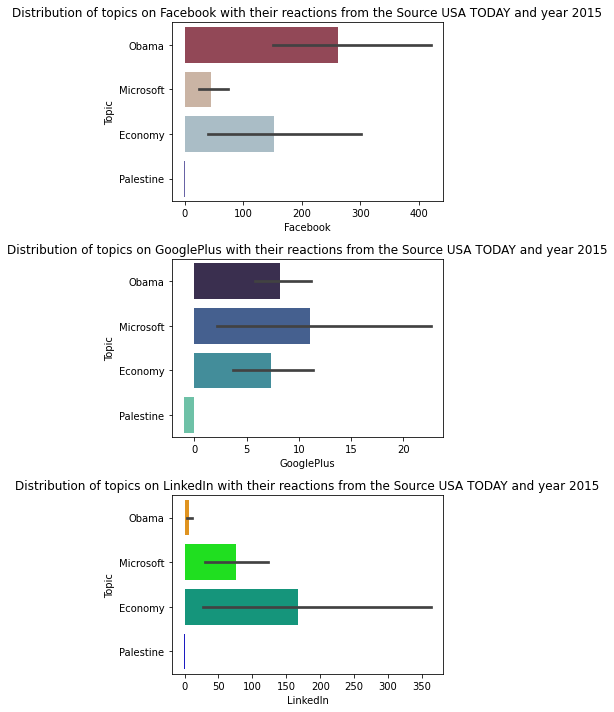

In [173]:
plt.figure(figsize=(5,10))
plt.subplot(3,1,1)
plt.title('Distribution of topics on Facebook with their reactions from the Source USA TODAY and year 2015')
sns.barplot(y='Topic',x='Facebook',data=case3,palette='twilight_shifted_r');
plt.subplot(3,1,2)
plt.title('Distribution of topics on GooglePlus with their reactions from the Source USA TODAY and year 2015')
sns.barplot(y='Topic',x='GooglePlus',data=case3,palette='mako');
plt.subplot(3,1,3)
plt.title('Distribution of topics on LinkedIn with their reactions from the Source USA TODAY and year 2015')
sns.barplot(y='Topic',x='LinkedIn',data=case3,palette='nipy_spectral_r');
plt.tight_layout()

In [151]:
ic(max(case3['Facebook']));
ic(max(case3['GooglePlus']));
ic(max(case3['LinkedIn']));

ic| max(case3['Facebook']): 5367
ic| max(case3['GooglePlus']): 64
ic| max(case3['LinkedIn']): 1242


- Eventhough the news published from this source are less on the social media the likes or reactions generated are relatively more.
- There are 115 news articles published on social media from the Source 'USA TODAY' consisting of various topics with 90 from Obama, 13 from Economy, 11 from Microsoft and 1 from Palestine.
- There are more likes on facebbok for this news published from the Source 'USA TODAY' than on Googleplus and LinkedIn.
- The likes generated on Facebook for the news from this Source are 5367, 64 likes on Googleplus and 1242 on LinkedIn.